<div style="background-color: #007BFF; height: 4px; width: 100%;"></div>

# **Data Exploration and Visualization of Survey Responses**

## *Overview*
This notebook explores missingness patterns in survey responses across different years and subsets of questions. The goal is to identify trends in missing data and understand how response patterns evolve over time.

## *Objectives*
- **Missingness Analysis:** Visualize and analyze missing data patterns for different subsets of questions across survey years.
- **Correlation Analysis:** Investigate potential correlations between general survey questions and suicidality-specific questions both within individual years and across multiple years.

## *Questions of Interest*

- School information
- Identity
- Linking questions
- Substance use
- PHQ-4
- Suicidality
- Adolescent psychotic-like symptoms
- Emotional reactivity
- Help seeking

<div style="background-color: #007BFF; height: 4px; width: 100%;"></div>

## **Libraries and Dependencies**

In [125]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from itertools import product
import seaborn as sns
from sklearn.cluster import KMeans
from scipy.stats import pearsonr

<div style="background-color: #007BFF; height: 4px; width: 100%;"></div>

## **Global Variables**

In this section, we will define some helpful global variables, including the final linked data and column names.

In [46]:
# Read formatted linked persons
final23 = pd.read_csv("final/final2023.csv")    # Linked class of 2023
final24 = pd.read_csv("final/final2024.csv")    # Linked class of 2024
final25 = pd.read_csv("final/final2025.csv")    # Linked class of 2025
final26 = pd.read_csv("final/final2026.csv")    # Linked class of 2026
all_linked = pd.concat([final23, final24, final25, final26], ignore_index=True, axis=0)

cohorts = range(2023, 2027)
years = range(2020, 2024)

final = {
    2023: final23,
    2024: final24,
    2025: final25,
    2026: final26,
}

/var/folders/sk/hy6bzzbx4rd98zc284jmxmkm0000gn/T/ipykernel_77136/2804755060.py:2: DtypeWarning: Columns (12,13,14,15,48,49,50,220,221,222,223,224,225,226,227,228,229,230,231,232,233,234,235,236,237,238,239,240,241,242,243,244,245,246,247,248,249,250,251,252,253,254,255,256,257,258,259,260,261,262,263,264,265,266,267,268,269,270,271,272,273,274,275,276,277,278,280,281,282,284,285,286,288,289,290,292,293,294,296,297,298,300,301,302,305,306,309,310,311,312,313,314,317,318,319,320,321,322,324,325,326,328,329,330,332,333,334,336,337,338,340,341,342,344,345,346,348,349,350,353,354,360,361,362,363,364,365,366,367,368,369,370,371,372,373,374,375,376,377,378,379,380,381,382,383,384,385,386,387,388,389,390,391,392,393,394,460,461,462,464,465,466,467,468,469,470,471,472,473,474,475,476,477,478,481,482,484,485,486,488,489,490,491) have mixed types. Specify dtype option on import or set low_memory=False.
  final23 = pd.read_csv("final/final2023.csv")    # Linked class of 2023
/var/folders/sk/hy6bzz

In [10]:
# All common questions across years

# Survey
survey = [
    "Unnamed: 0",
    "IDX.INT.Origin.Database",
    "IDX.INT.Origin.Record",
    "SSS.INT.SurveyYear",
    "IDX.INT.Row",
    "IDX.CHR.Linked.ID",
    "QCC.LGC.Linked.Attempted",
    "QCC.LGC.Linked",
    "QCC.LGC.Linked.No_issues",
    "QCC.CHR.Linked.Score.Base",
    "QCC.CHR.Linked.Score.Add",
    "QCC.CHR.Linked.Rows",
    "QCC.CHR.Linked.Dissimilarity",
]
   
# Adolescent Psychotic-like Symptoms 
psychotic = [
    "INV.DBL.APSS.Q1.MindReading",
    "INV.DBL.APSS.Q2.TVRadio",
    "INV.DBL.APSS.Q3.Spying",
    "INV.DBL.APSS.Q4.Auditory",
    "INV.DBL.APSS.Q5.Controlled",
    "INV.DBL.APSS.Q6.Visual",
    "INV.DBL.APSS.Q7.Grandiosity",
    "INV.DBL.APSS.Total",
]
    
# Emotional Reactivity 
emotional = [
    "INV.INT.ERS.IntensityArousalTotal",
    "INV.INT.ERS.PersistenceTotal",
    "INV.INT.ERS.Q01.Persistence1",
    "INV.INT.ERS.Q02.Sensitivity1",
    "INV.INT.ERS.Q03.IntensityArousal1",
    "INV.INT.ERS.Q04.IntensityArousal2",
    "INV.INT.ERS.Q05.Sensitivity2",
    "INV.INT.ERS.Q06.IntensityArousal3",
    "INV.INT.ERS.Q07.Sensitivity3",
    "INV.INT.ERS.Q08.Persistence2",
    "INV.INT.ERS.Q09.Sensitivity4",
    "INV.INT.ERS.Q10.Persistence3",
    "INV.INT.ERS.Q11.Persistence4",
    "INV.INT.ERS.Q12.Sensitivity5",
    "INV.INT.ERS.Q13.Sensitivity6",
    "INV.INT.ERS.Q14.Sensitivity7",
    "INV.INT.ERS.Q15.Sensitivity8",
    "INV.INT.ERS.Q16.Sensitivity9",
    "INV.INT.ERS.Q17.IntensityArousal4",
    "INV.INT.ERS.Q18.Sensitivity10",
    "INV.INT.ERS.Q19.IntensityArousal5",
    "INV.INT.ERS.Q20.IntensityArousal6",
    "INV.INT.ERS.Q21.IntensityArousal7",
    "INV.INT.ERS.SensitivityTotal",
    "INV.INT.ERS.Total",
]
    
# PHQ4
phq4 = [
    "INV.INT.PHQ4.Anxiety",
    "INV.INT.PHQ4.Depression",
    "INV.INT.PHQ4.Q1.Anxious",
    "INV.INT.PHQ4.Q2.Worried",
    "INV.INT.PHQ4.Q3.Depressed",
    "INV.INT.PHQ4.Q4.Anhedonia",
    "INV.INT.PHQ4.Total",
    "INV.LGL.PHQ4.Anxiety",
    "INV.LGL.PHQ4.Depression",
    "INV.FCT.PHQ4.Total",
]
    
# Suicidality
suicide = [
    "INV.INT.SI.Attempt",
    "INV.INT.SI.How",
    "INV.INT.SI.Selfharm",
    "INV.INT.SI.Thoughts",
]
    
# Substance Use
substance = [
    "INV.INT.SUB.Alcohol.Past30",
    "INV.INT.SUB.Cannabis.Past30",
    "INV.INT.SUB.Cigarettes.Past30",
    "INV.INT.SUB.Cigars.Past30",
    "INV.INT.SUB.Smokeless.Past30",
    "INV.INT.SUB.Vapes.Past30",
    
    "INV.LGL.SUB.Alcohol.Life",
    "INV.LGL.SUB.Cannabis.Life",
    "INV.LGL.SUB.Cigarettes.Life",
    "INV.LGL.SUB.Cigars.Life",
    "INV.LGL.SUB.Smokeless.Life",
    "INV.LGL.SUB.Vapes.Life",
]
    
# Help Seeking
help = [
    "INV.LGL.HelpSeeking0",
    "INV.LGL.HelpSeeking1",
    "INV.LGL.HelpSeeking10",
    "INV.LGL.HelpSeeking11",
    "INV.LGL.HelpSeeking12",
    "INV.LGL.HelpSeeking13",
    "INV.LGL.HelpSeeking2",
    "INV.LGL.HelpSeeking3",
    "INV.LGL.HelpSeeking4",
    "INV.LGL.HelpSeeking5",
    "INV.LGL.HelpSeeking6",
    "INV.LGL.HelpSeeking7",
    "INV.LGL.HelpSeeking8",
    "INV.LGL.HelpSeeking9",
    "INV.CHR.HelpSeeking.Other",
]
    
# Identity
identity = [
    "SBJ.CHR.Gender.Other",
    "SBJ.CHR.Link.Streetname",
    "SBJ.CHR.SexualOrientation.Other",
    "SBJ.FCT.Ethnicity",
    "SBJ.FCT.GenderId",
    "SBJ.FCT.Link.BirthMonth",
    "SBJ.FCT.Link.EyeColor",
    "SBJ.FCT.Link.MiddleInitial",
    "SBJ.FCT.Link.OlderSiblings",
    "SBJ.FCT.Race",
    "SBJ.FCT.Sex",
    "SBJ.FCT.Sexuality",
    "SBJ.INT.Link.KindergartenYearEst",
    "SBJ.LGL.Race.AmericanIndianAlaskaNative",
    "SBJ.LGL.Race.Asian",
    "SBJ.LGL.Race.HaitianBlackAfricanAmerican",
    "SBJ.LGL.Race.HawaiianPacificIslander",
    "SBJ.LGL.Race.MiddleEasternNorthAfrican",
    "SBJ.LGL.Race.Multiple",
    "SBJ.LGL.Race.Other",
    "SBJ.LGL.Race.White",
]
    
# School
school = [
    "SSS.CHR.GradesSurveyed",
    "SSS.DBL.PercentOptOutsbyGrades",
    "SSS.DBL.PercentOptOutsbySchool",
    "SSS.INT.Cohort",
    "SSS.INT.District.Code",
    "SSS.INT.Eighth.Grade.Enrollment",
    "SSS.INT.Eleventh.Grade.Enrollment",
    "SSS.INT.Fifth.Grade.Enrollment",
    "SSS.INT.Grade",
    "SSS.INT.Ninth.Grade.Enrollment",
    "SSS.INT.School.Code",
    "SSS.INT.Seventh.Grade.Enrollment",
    "SSS.INT.Sixth.Grade.Enrollment",
    "SSS.INT.Tenth.Grade.Enrollment",
    "SSS.INT.Time_point",
    "SSS.INT.Twelfth.Grade.Enrollment",
]

<div style="background-color: #007BFF; height: 4px; width: 100%;"></div>

## **Analyzing Missingness Patterns**

In [26]:
# generate missingness patterns for a given cohort and column
def get_missingness_patterns(df, col):
    years = [2020, 2021, 2022, 2023]
    cohort_cols = [f"{col}{year}" for year in years]

    existing_cols = [col for col in cohort_cols if col in df.columns]
    missingness_patterns = df[existing_cols].notna().astype(int).astype(str).agg("".join, axis=1)

    return missingness_patterns.value_counts().sort_index()

In [ ]:
# order missingness by severity
def sort_patterns_by_missingness(pattern_counts):
    return sorted(pattern_counts.index, key=lambda x: x.count("1"), reverse=True)

In [34]:
# plot stacked bar chart with missingness-based colors
def plot_stacked_bar(columns):
    for col in columns:
        plt.figure(figsize=(10, 6))
        missingness_data = {}

        for cohort in cohorts:
            pattern_counts = get_missingness_patterns(final[cohort], col)
            missingness_data[cohort] = pattern_counts

        # Convert to DataFrame
        missingness_df = pd.DataFrame(missingness_data).fillna(0)

        # Reorder missingness patterns from least missing to most missing
        ordered_patterns = sort_patterns_by_missingness(missingness_df)
        missingness_df = missingness_df.reindex(ordered_patterns)

        # Define a colormap from low to high missingness
        cmap = sns.color_palette("magma_r", n_colors=len(ordered_patterns))

        # Stacked bar chart
        missingness_df.T.plot(kind="bar", stacked=True, figsize=(10, 6), color=cmap)
        plt.xlabel("Cohort")
        plt.ylabel("Frequency")
        plt.title(f"Missingness Patterns for {col}")
        plt.xticks(rotation=0)
        plt.legend(title="Missingness Pattern", bbox_to_anchor=(1.05, 1), loc='upper left')
        plt.grid(axis="y", linestyle="--", alpha=0.7)
        plt.show()


In [38]:

def plot_heatmap(columns):
    for col in columns:
        missingness_data = {}

        for cohort in cohorts:
            pattern_counts = get_missingness_patterns(final[cohort], col)
            missingness_data[cohort] = pattern_counts

        # Convert to DataFrame
        missingness_df = pd.DataFrame(missingness_data).fillna(0)

        # Reorder patterns from least missing to most missing
        ordered_patterns = sort_patterns_by_missingness(missingness_df)
        missingness_df = missingness_df.reindex(ordered_patterns)

        plt.figure(figsize=(10, 6))
        sns.heatmap(
            missingness_df, 
            annot=True, 
            fmt=".0f", 
            cmap="magma_r",  # Reverse magma to ensure more missing = darker
            linewidths=0.5
        )
        plt.xlabel("Cohort")
        plt.ylabel("Missingness Pattern")
        plt.title(f"Heatmap of Missingness Patterns for {col}")
        plt.show()


In [40]:
# Function to generate and plot missingness patterns with stacked bar and heatmap
def plot_missingness_patterns(columns):
    for col in columns:
        missingness_data = {}

        for cohort in cohorts:
            pattern_counts = get_missingness_patterns(final[cohort], col)
            missingness_data[cohort] = pattern_counts

        # Convert to DataFrame
        missingness_df = pd.DataFrame(missingness_data).fillna(0)

        # Reorder missingness patterns from least missing to most missing
        ordered_patterns = sort_patterns_by_missingness(missingness_df)
        missingness_df = missingness_df.reindex(ordered_patterns)

        # Define colormap where more missingness = darker
        cmap = sns.color_palette("magma_r", n_colors=len(ordered_patterns))

        # Create a single figure with 2 subplots
        fig, axes = plt.subplots(1, 2, figsize=(16, 6))
        fig.suptitle(f"Missingness Patterns for {col}", fontsize=16)

        # Stacked Bar Chart
        missingness_df.T.plot(kind="bar", stacked=True, ax=axes[0], color=cmap)
        axes[0].set_xlabel("Cohort")
        axes[0].set_ylabel("Frequency")
        axes[0].set_title("Stacked Bar Chart")
        axes[0].tick_params(axis='x', rotation=0)
        axes[0].legend(title="Missingness Pattern", bbox_to_anchor=(1.05, 1), loc='upper left')
        axes[0].grid(axis="y", linestyle="--", alpha=0.7)

        # Heatmap
        sns.heatmap(missingness_df, annot=True, fmt=".0f", cmap="magma_r", linewidths=0.5, ax=axes[1])
        axes[1].set_xlabel("Cohort")
        axes[1].set_ylabel("Missingness Pattern")
        axes[1].set_title("Heatmap")

        # Adjust layout
        plt.tight_layout(rect=[0, 0, 1, 0.95])  # Ensure the title doesn't overlap
        plt.show()


_______

#### **Substance Use**

Have you ever used/tried...

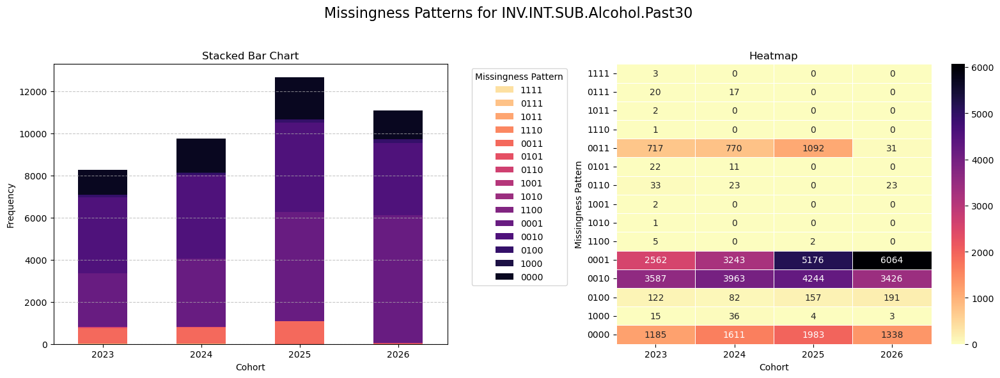

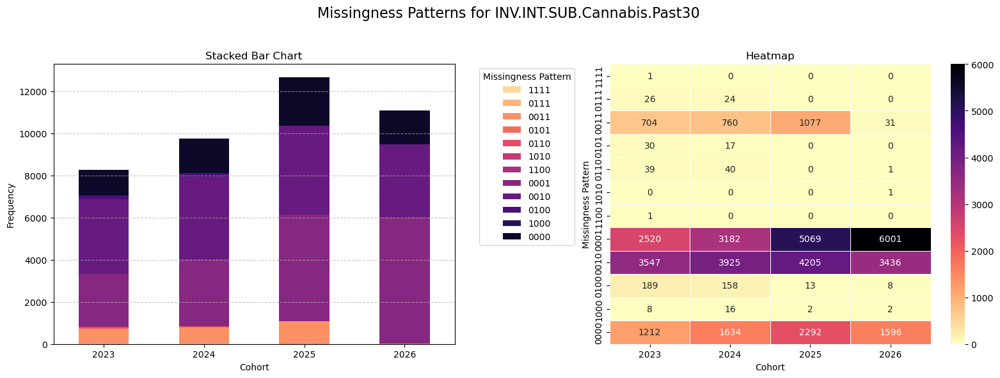

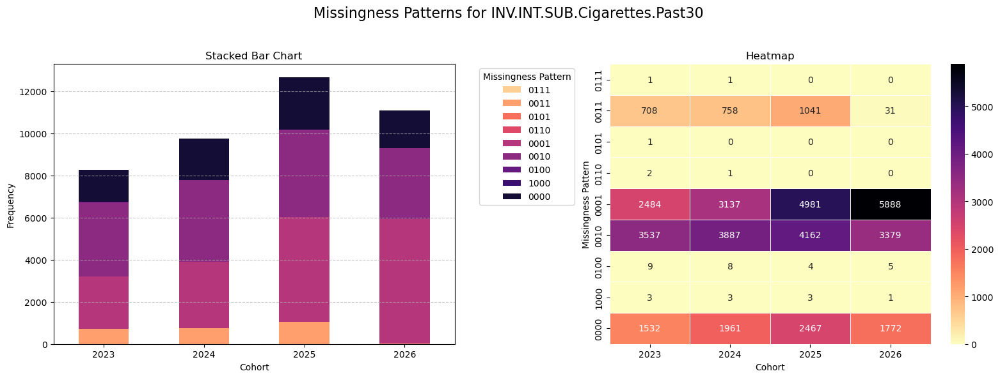

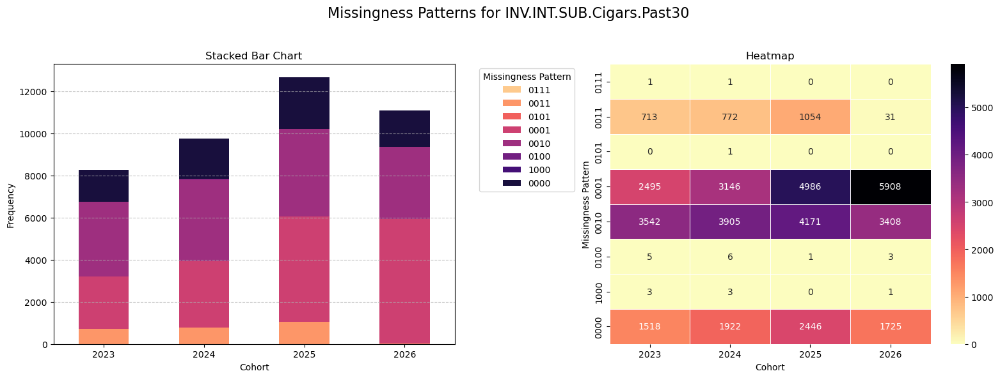

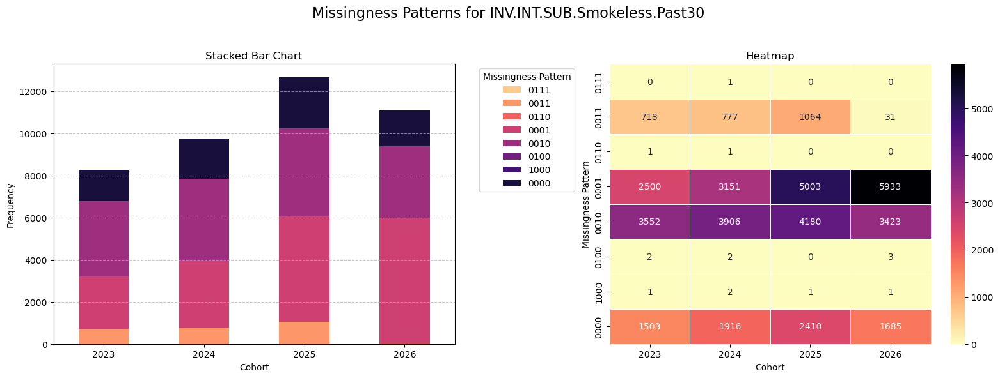

...

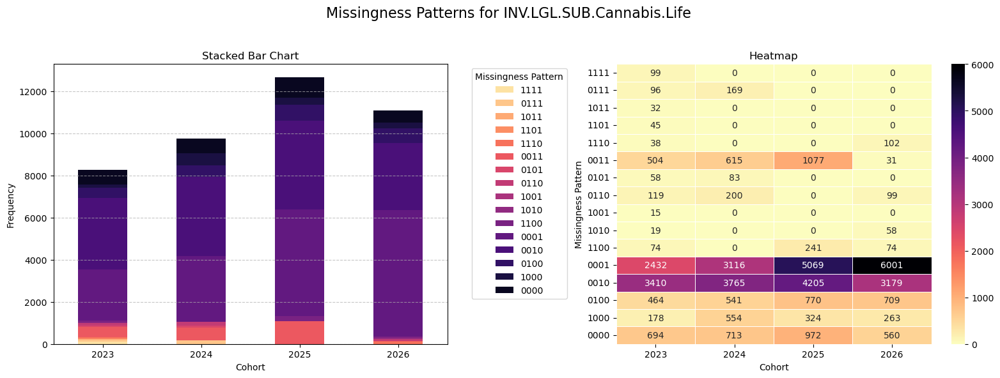

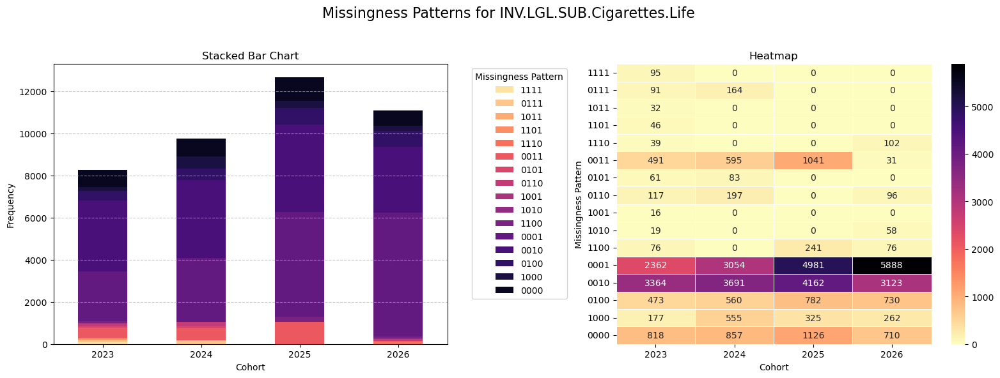

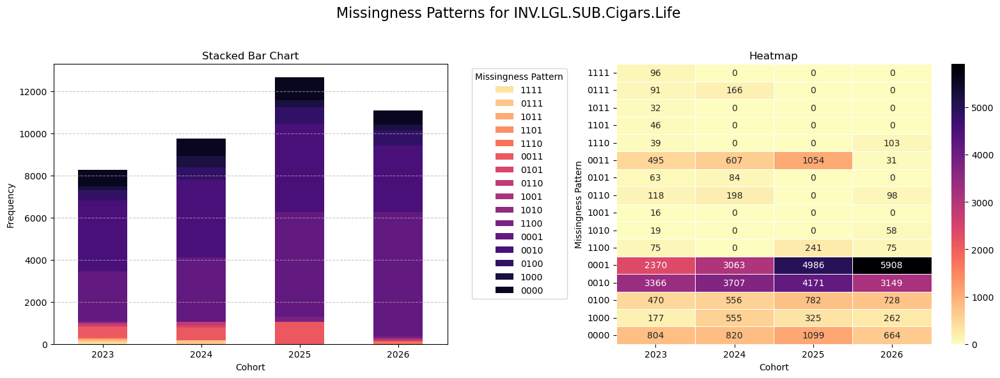

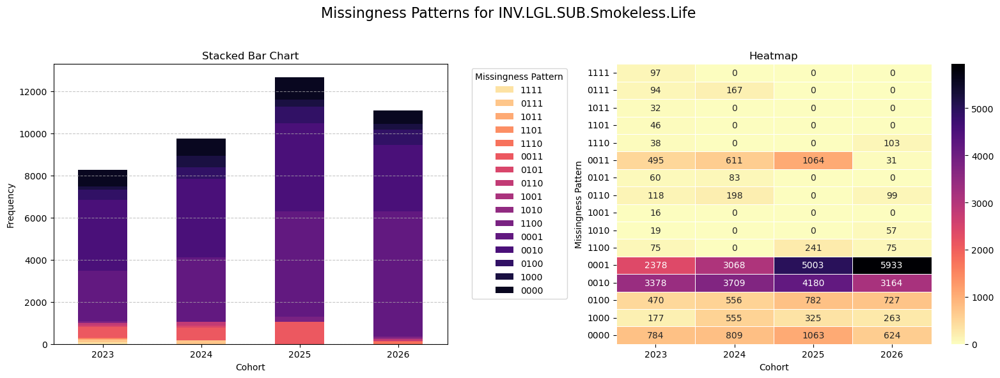

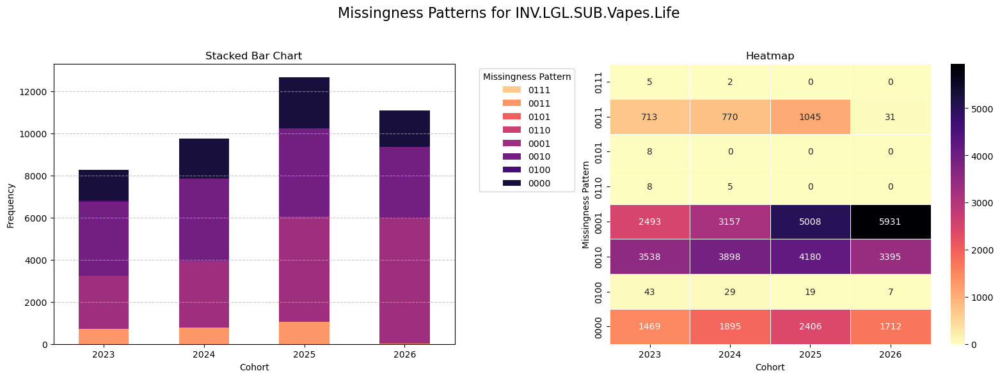

In [41]:
plot_missingness_patterns(substance)

_______

#### **PHQ4**

Over the last 2 weeks, how often have you been bothered by...

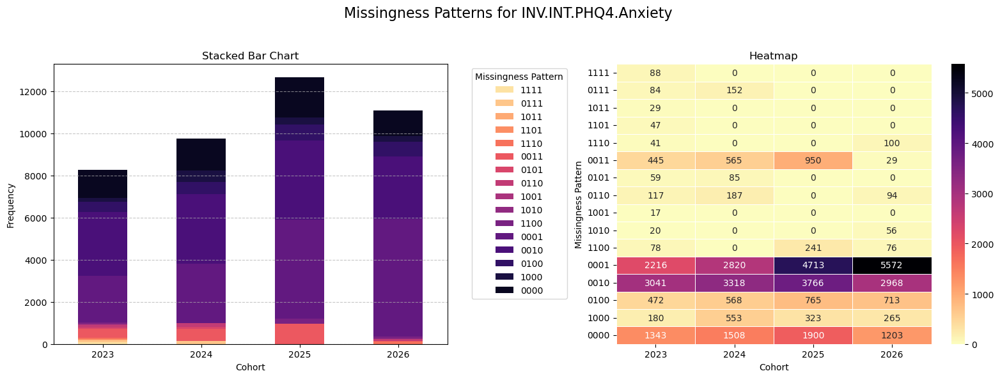

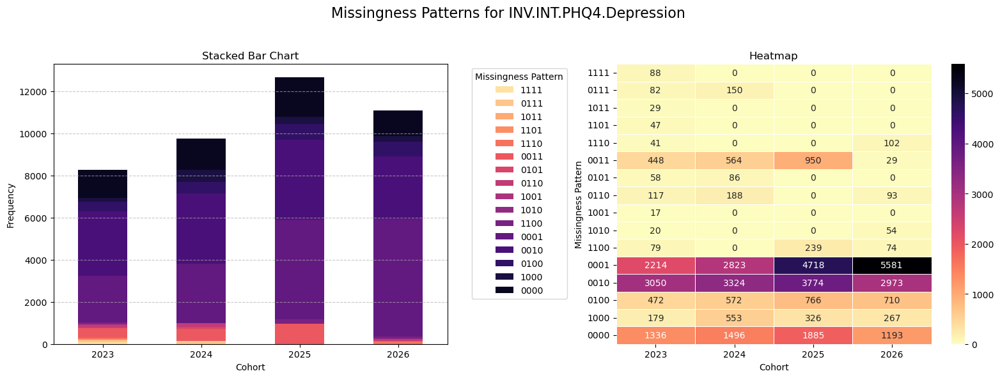

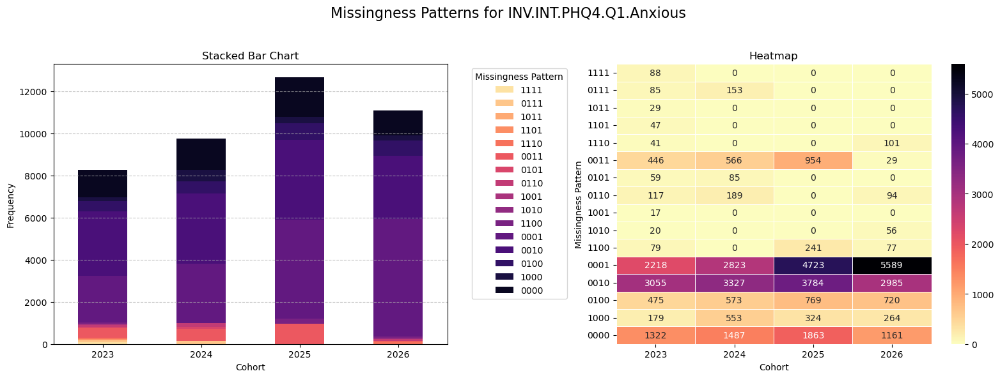

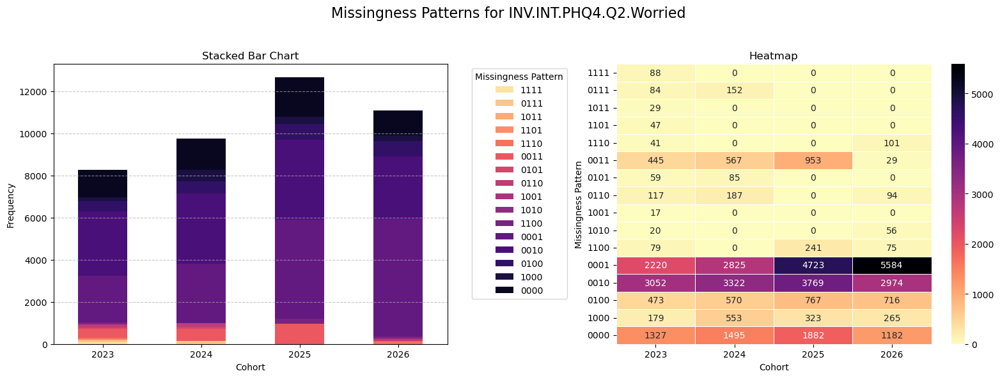

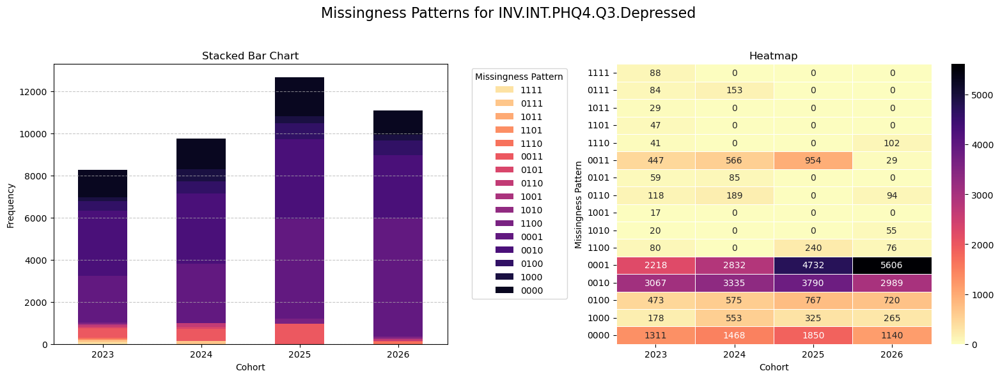

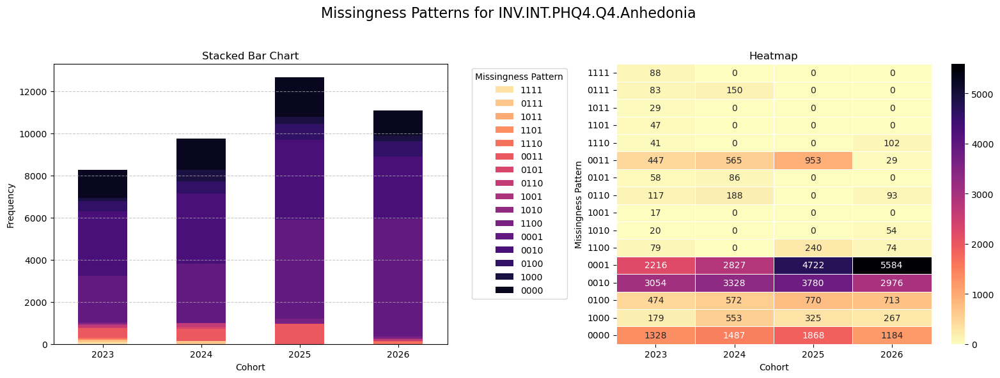

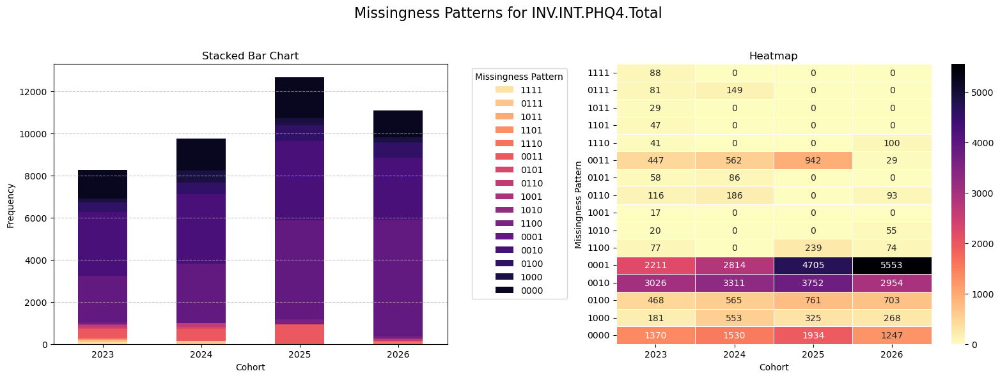

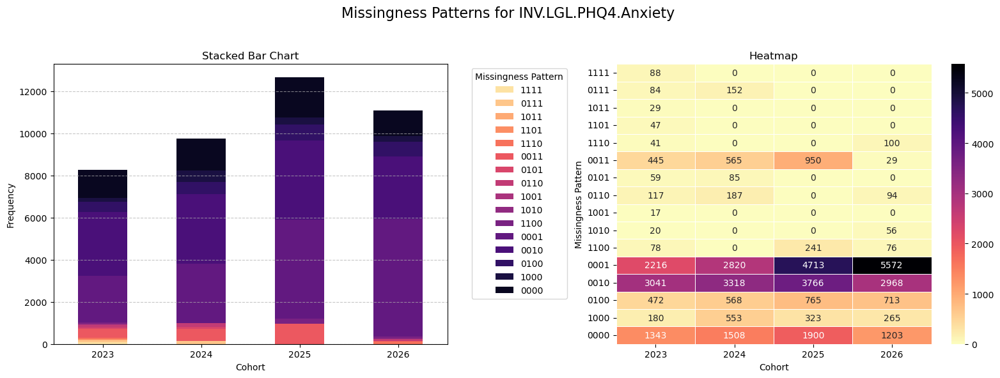

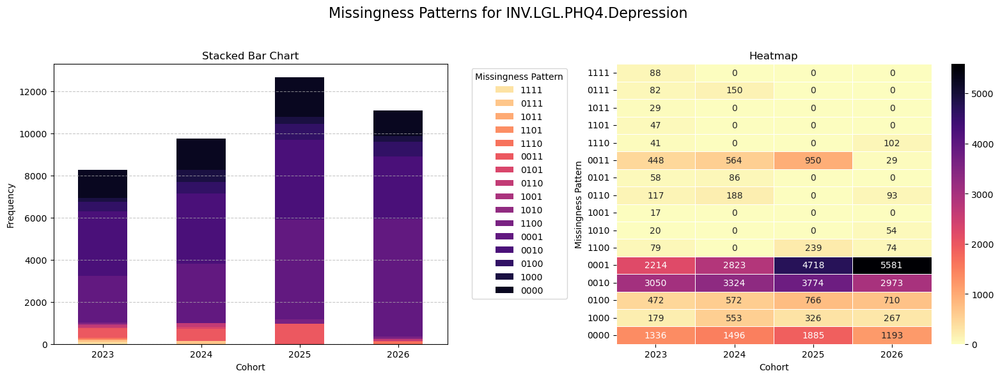

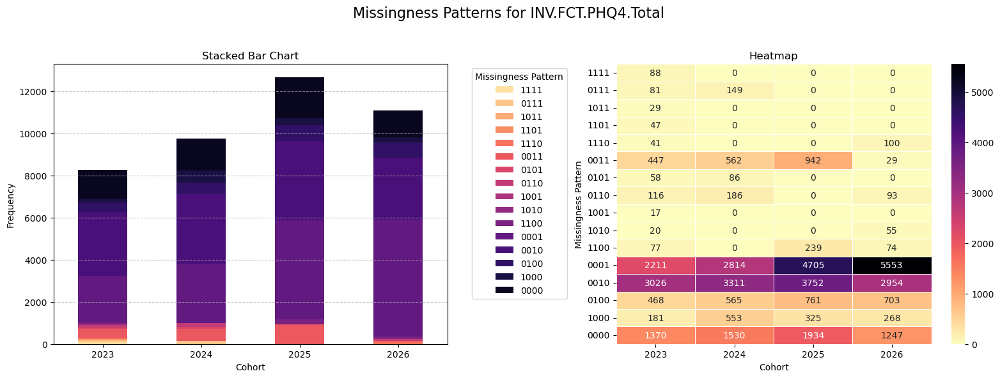

In [42]:
plot_missingness_patterns(phq4)

_______

#### **Suicidality**

Sometimes people feel so depressed about the future that they may consider attempting suicide, that is, taking some action to end their own life. During the past 12 months...

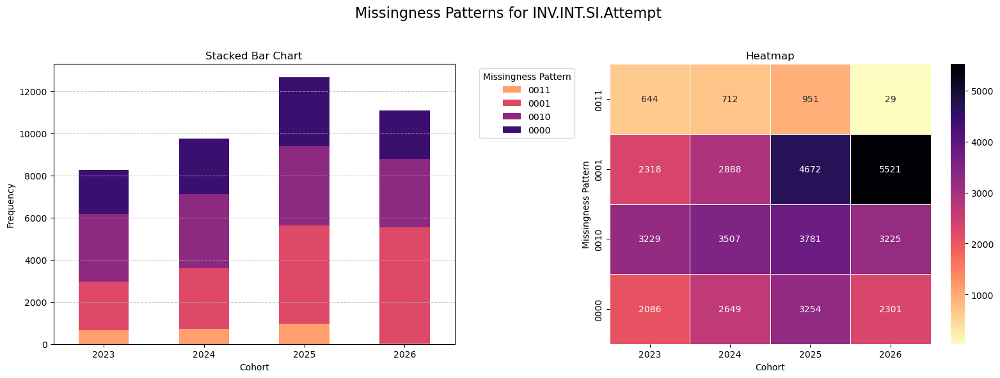

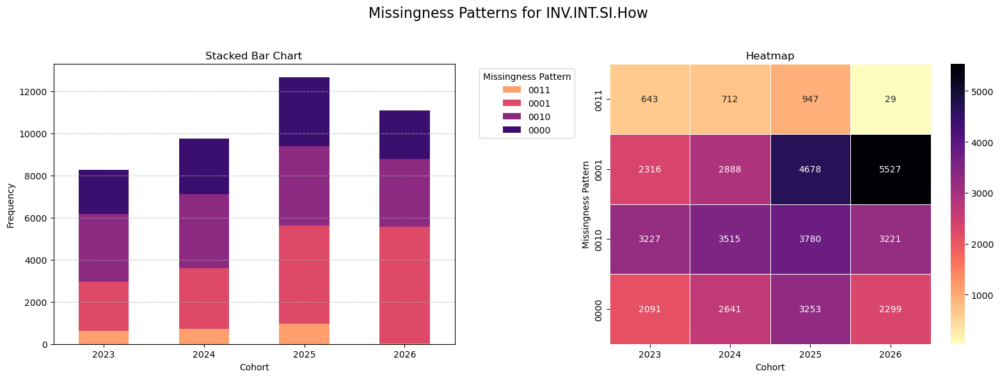

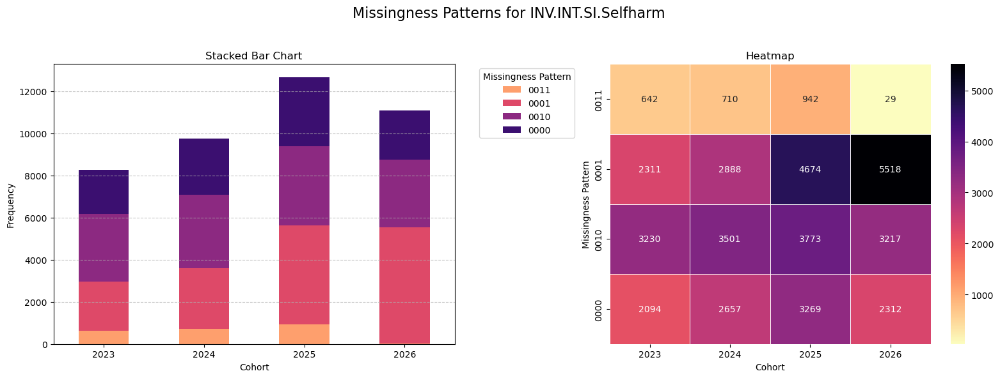

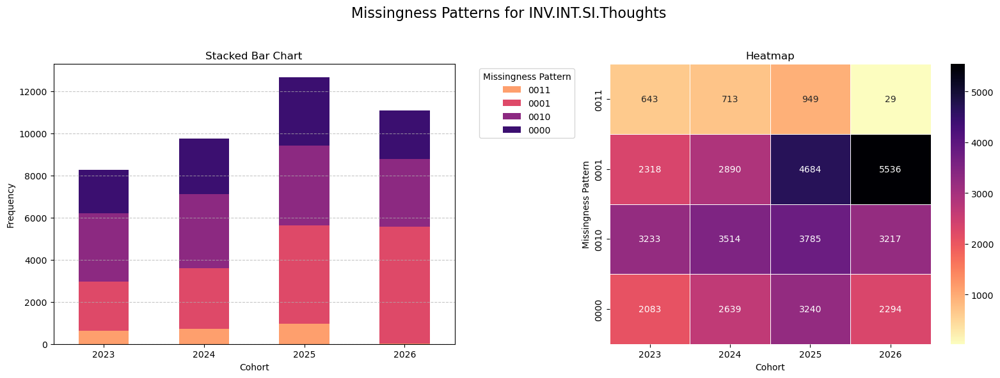

In [43]:
plot_missingness_patterns(suicide)

_______

#### **Adolescent Psychotic-Like Symptoms**

In the past 12 months, which of the following people have you talked with about your mental or emotional health (for example, for your feelings, mood, or behavior)? Check all that apply.

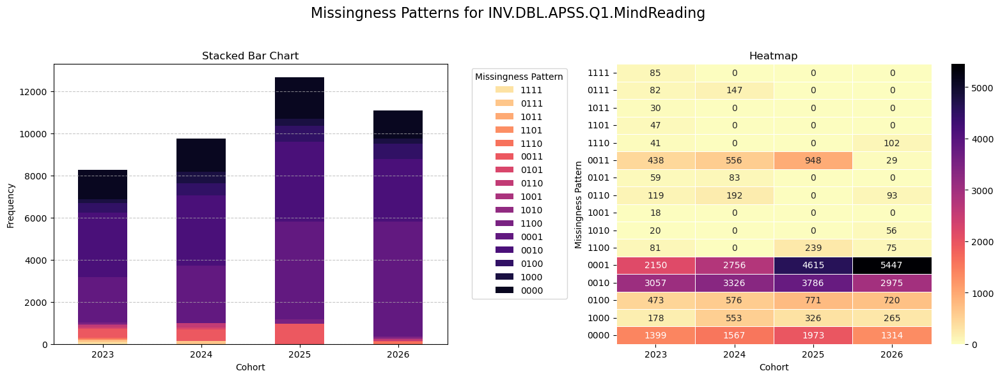

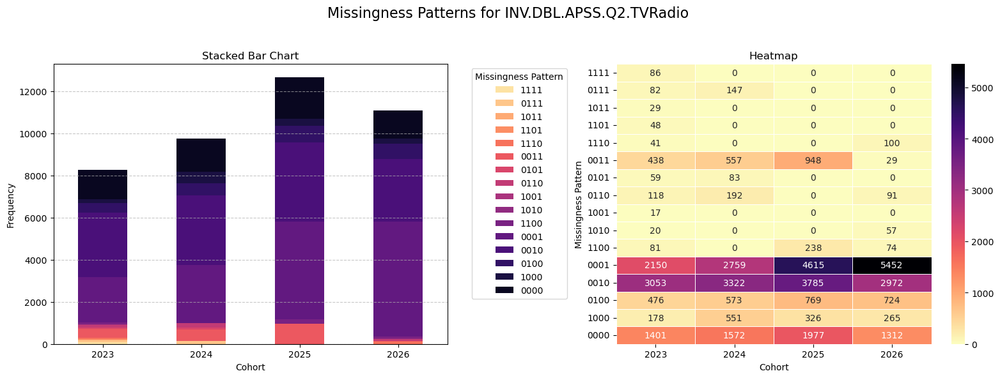

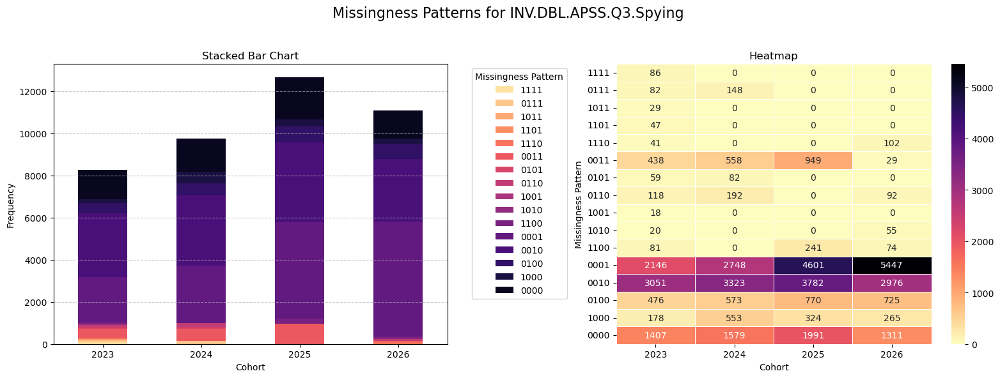

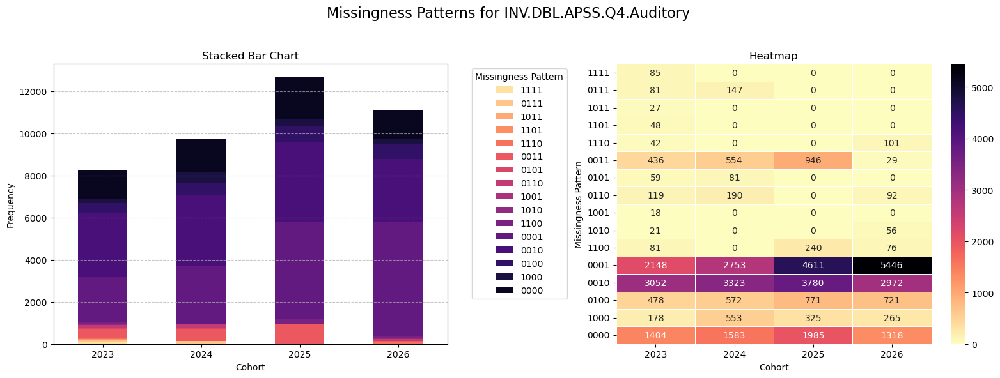

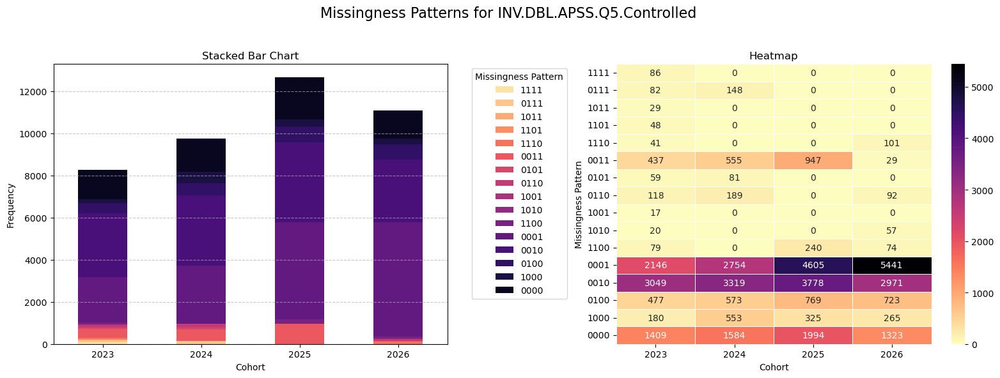

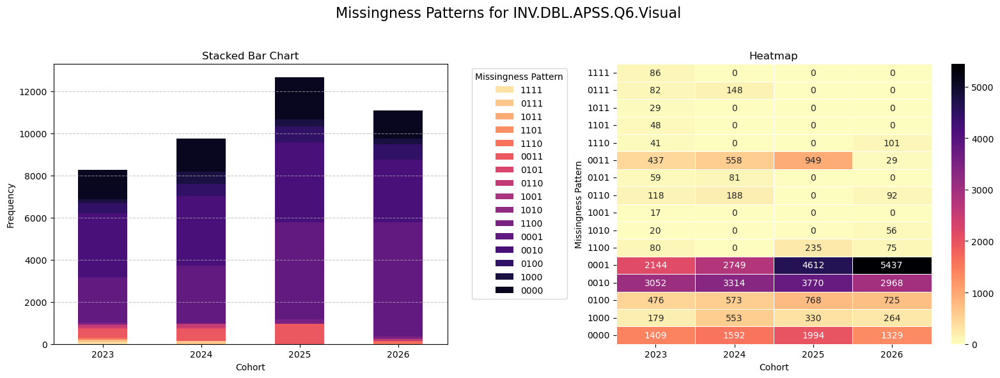

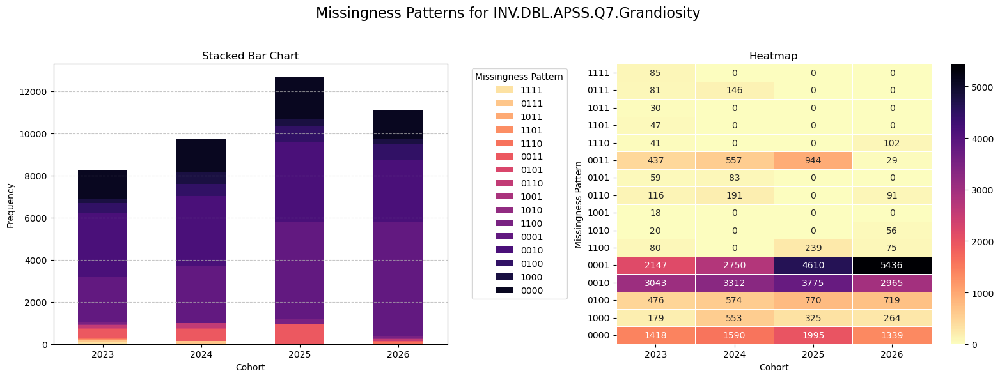

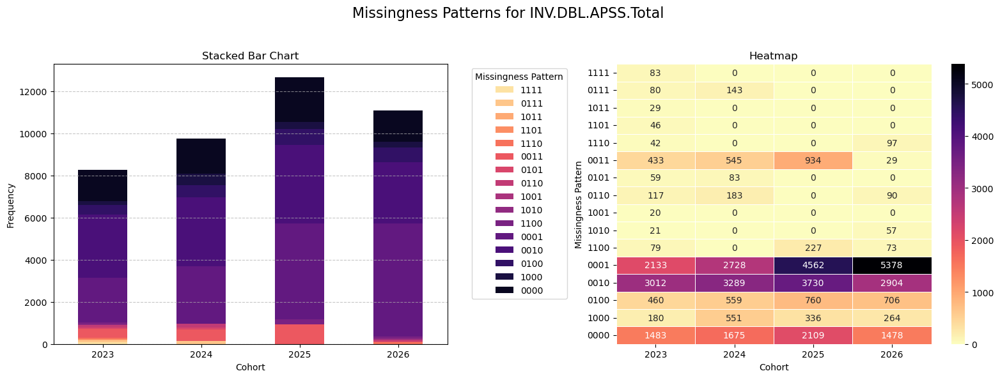

In [44]:
plot_missingness_patterns(psychotic)

_______

#### **Emotional Reactivity**

Emotional Reactivity Scale

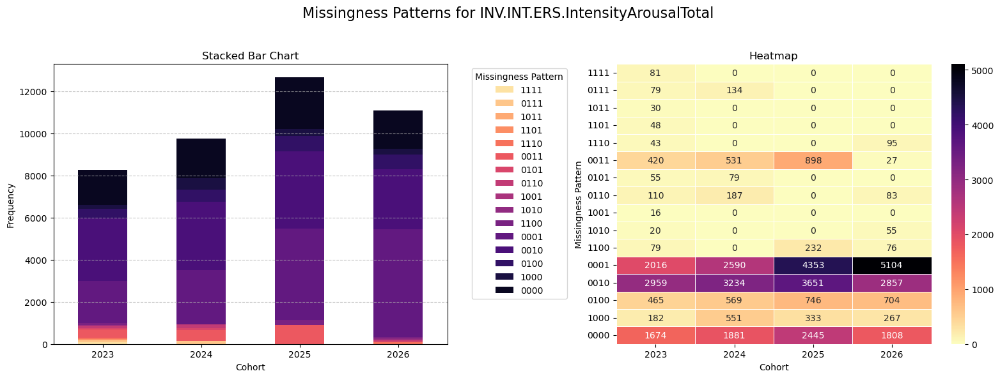

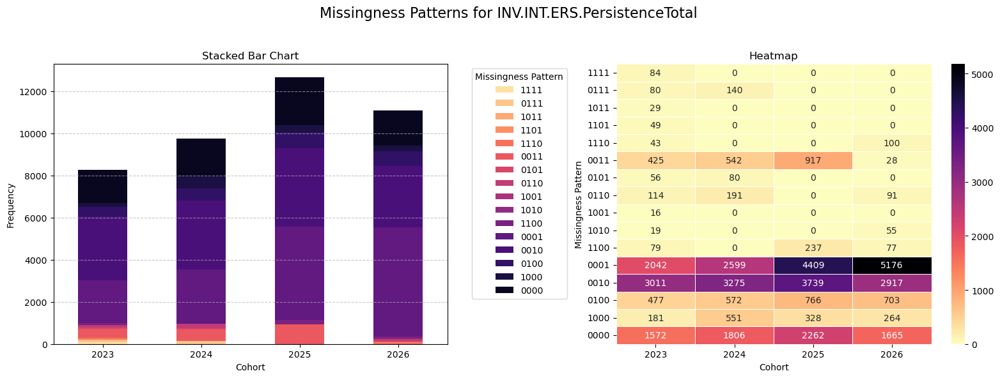

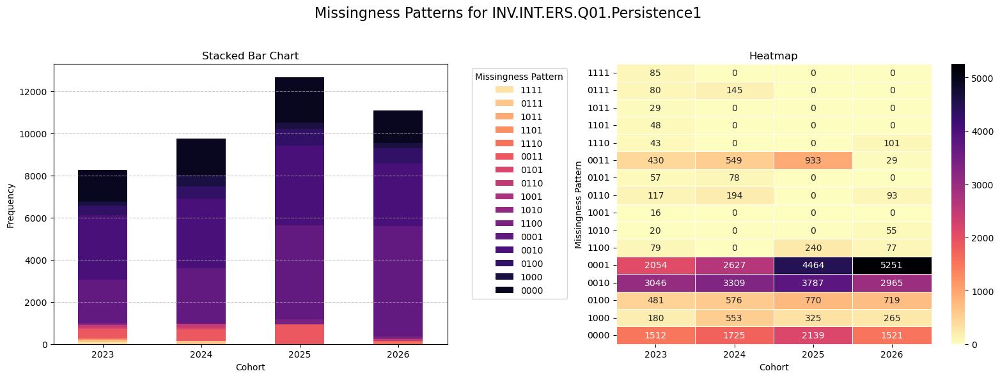

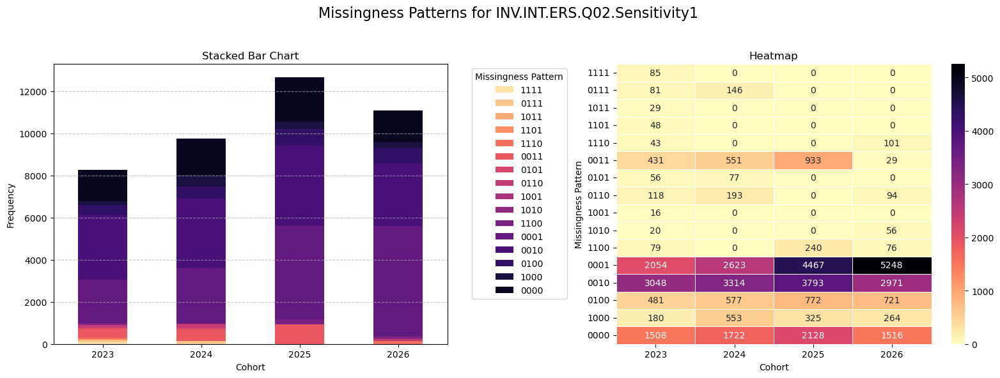

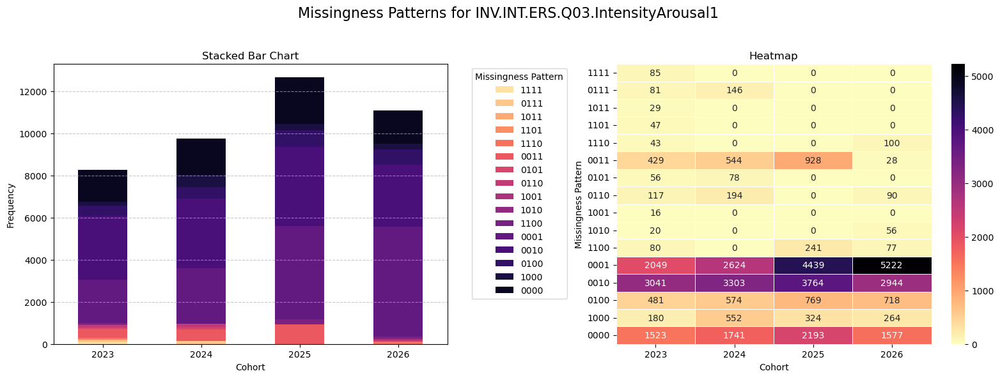

...

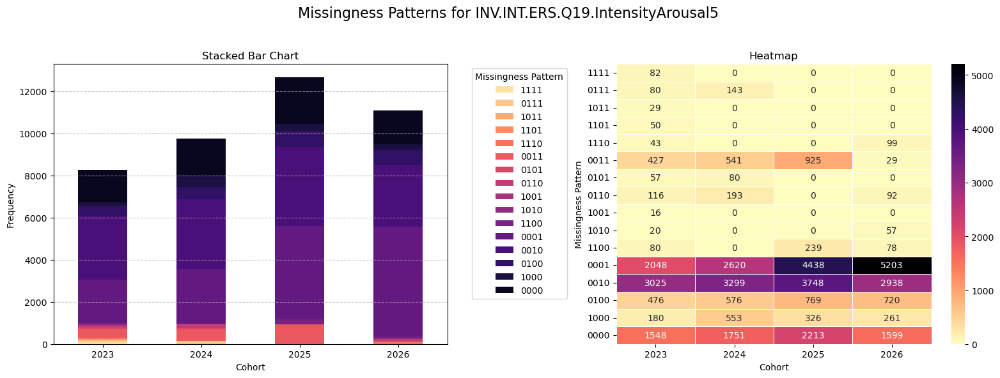

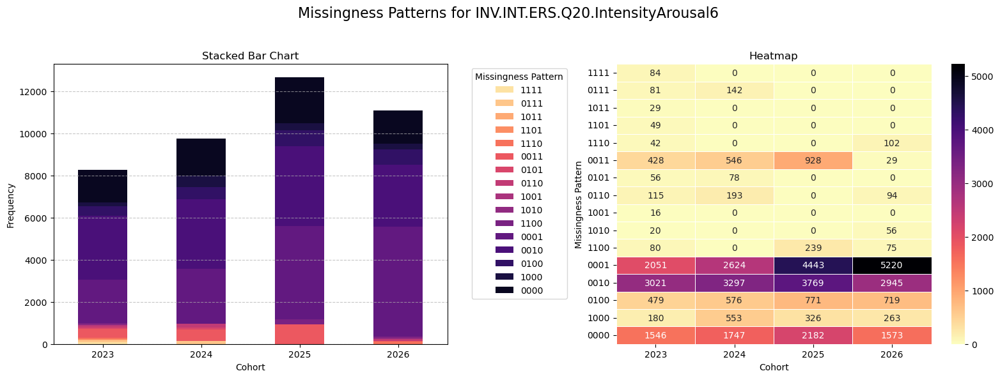

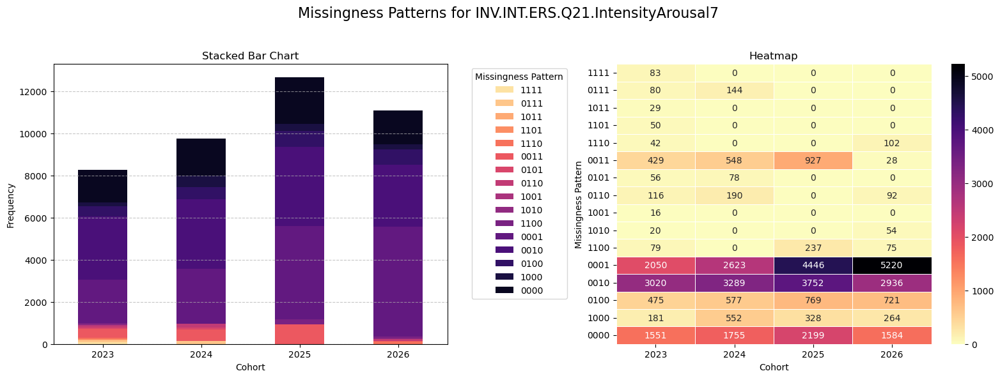

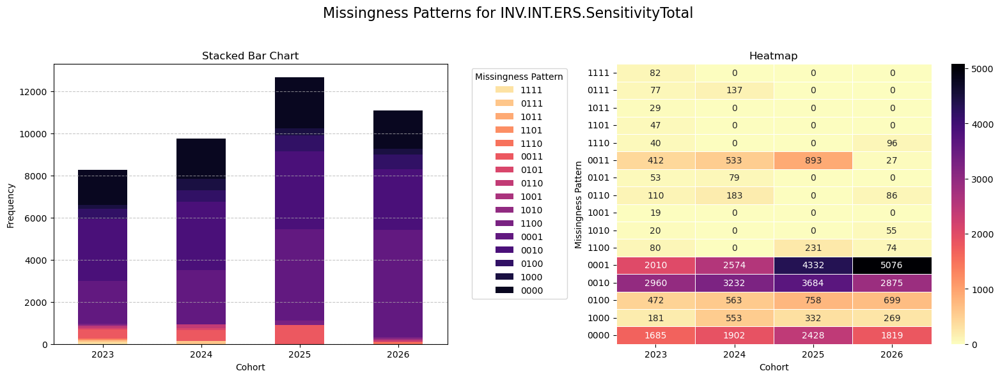

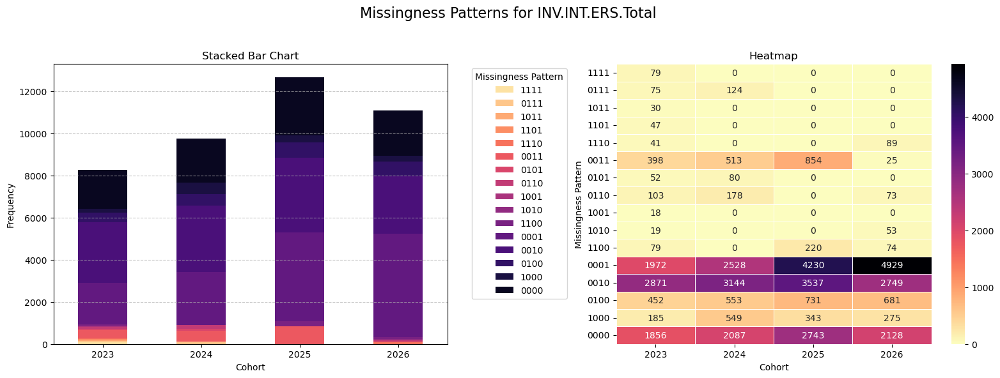

In [45]:
plot_missingness_patterns(emotional)

_______

#### **Help Seeking**

In the past 12 months, which of the following people have you talked with about your mental or emotional health (for example, for your feelings, mood, or behavior)? Check all that apply.

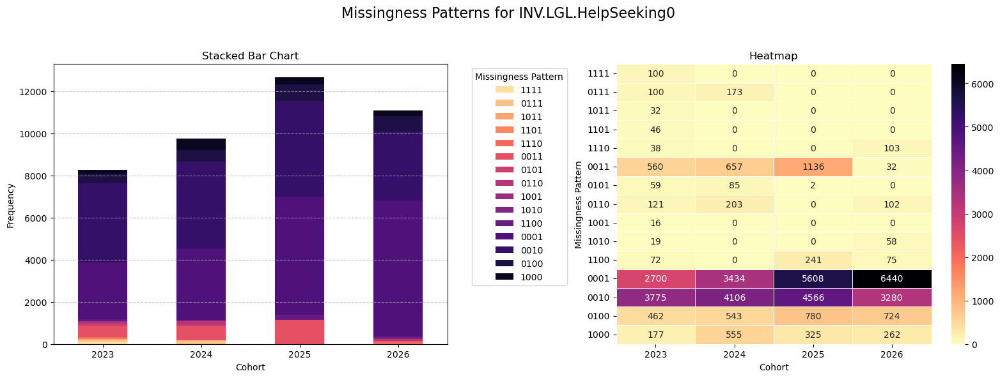

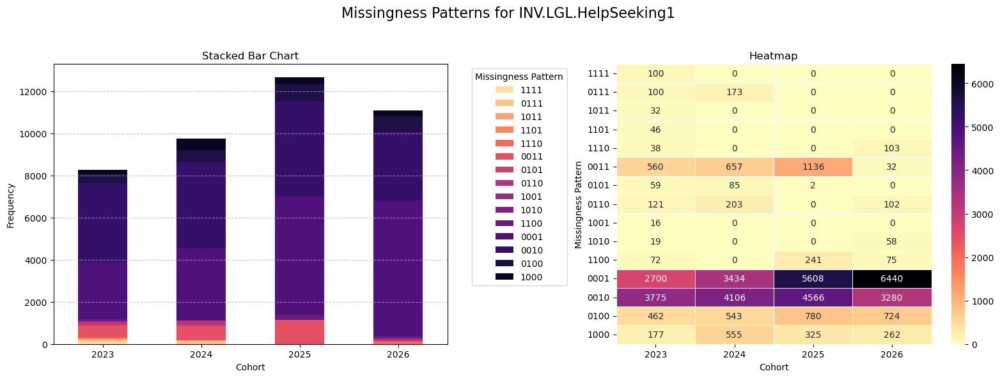

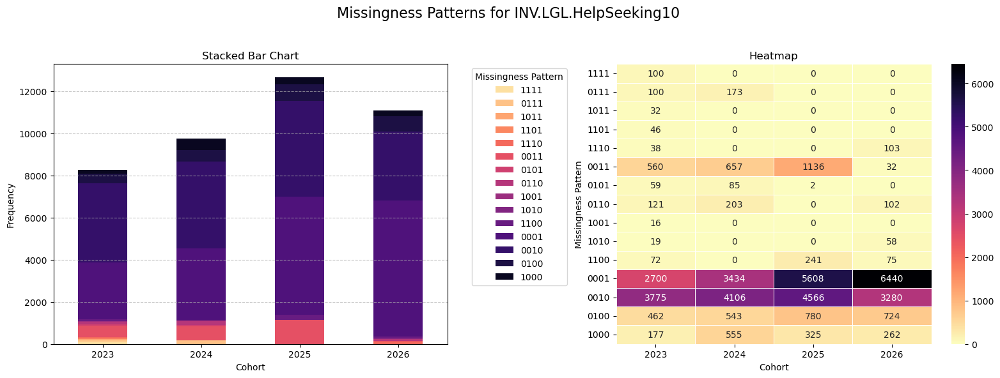

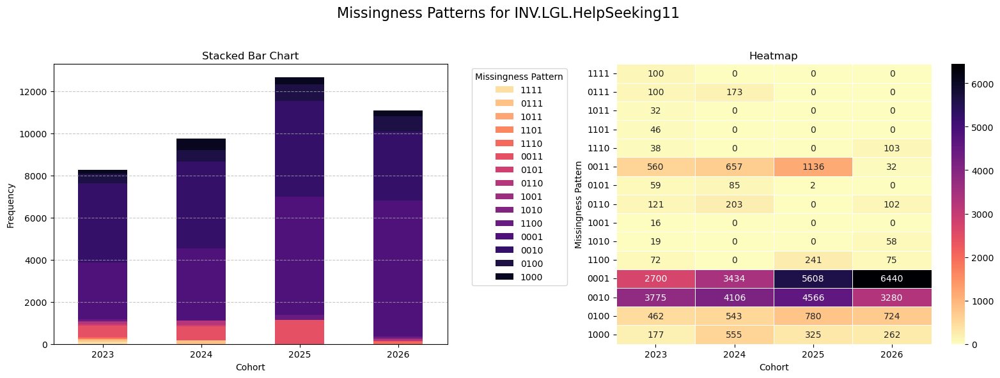

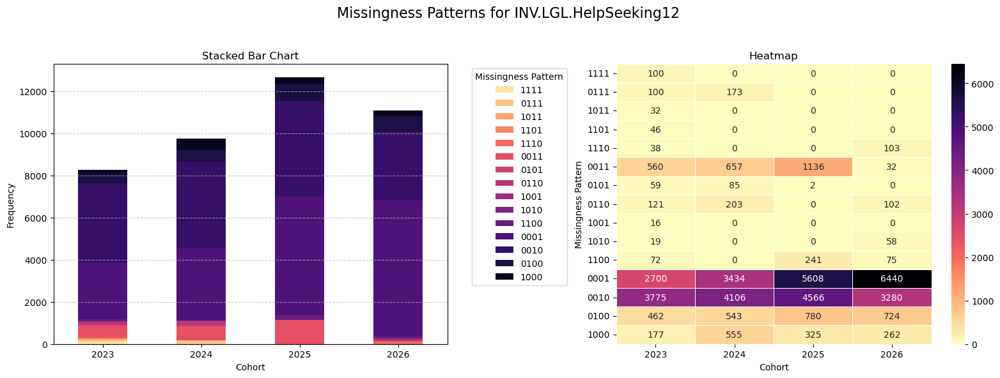

...

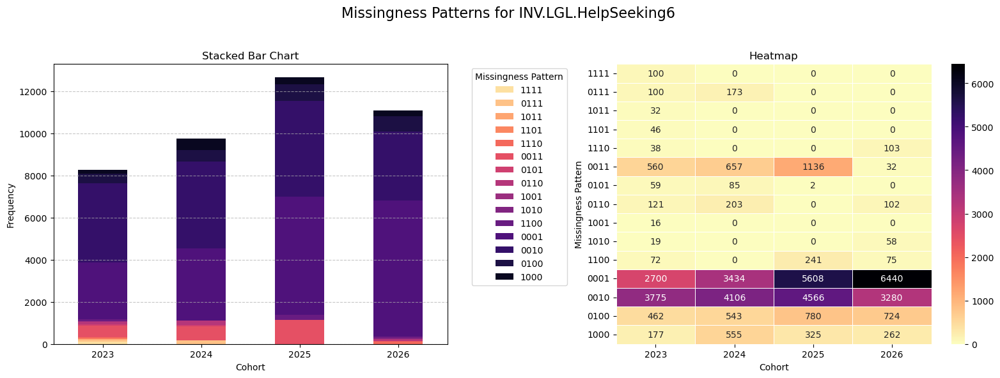

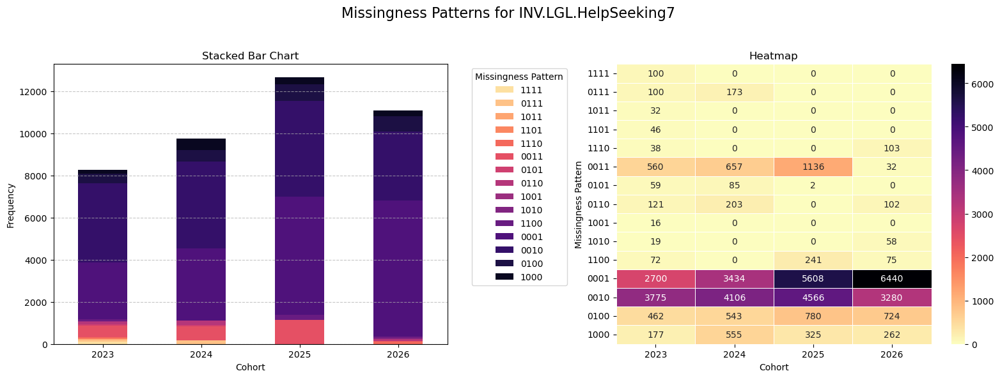

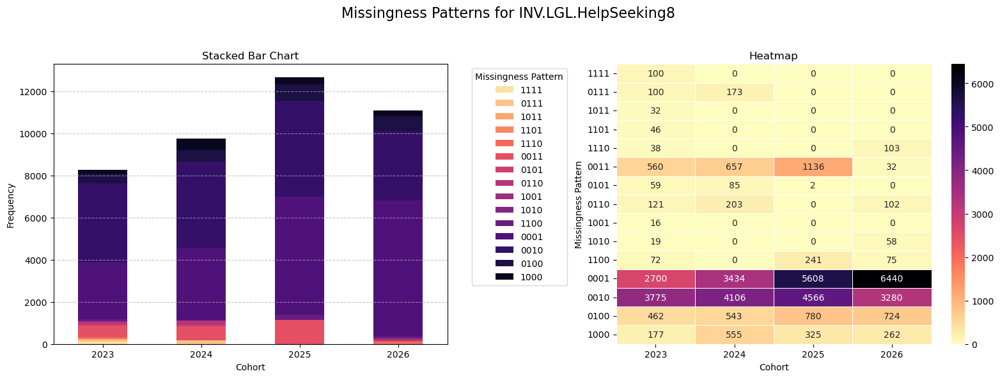

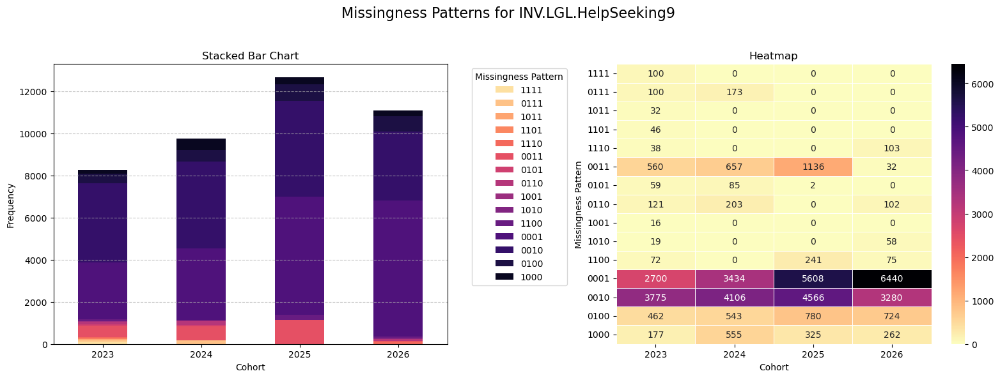

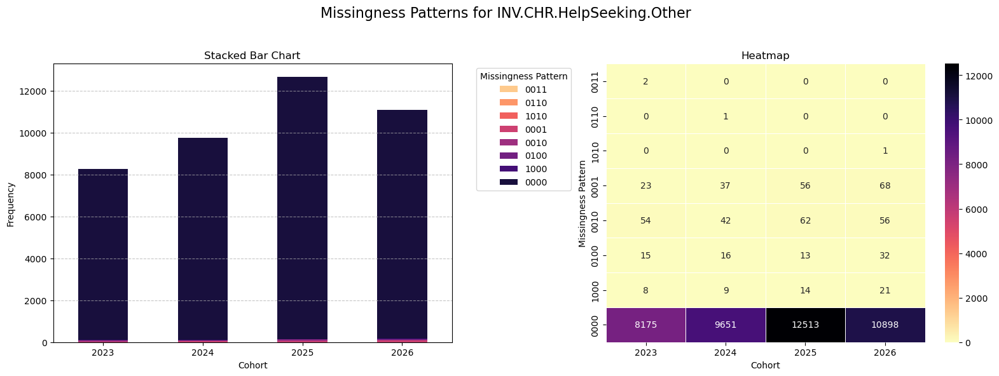

In [46]:
plot_missingness_patterns(help)

<div style="background-color: #007BFF; height: 4px; width: 100%;"></div>

## **Finding Correlations**

In [67]:
# format column names  - f"{col}{year}"
def get_yearly_columns(base_cols, years):
    return [f"{col}{year}" for col in base_cols for year in years]

In [68]:
# extract relevant columns for specific cohort
def get_cohort_data(df, base_cols, cohort, years):
    cohort_cols = get_yearly_columns(base_cols, years)
    cohort_df = df[
        (df["SSS.INT.Cohort2020"] == cohort) |
        (df["SSS.INT.Cohort2021"] == cohort) |
        (df["SSS.INT.Cohort2022"] == cohort) |
        (df["SSS.INT.Cohort2023"] == cohort)
    ]
    return cohort_df[cohort_cols]  # Only return valid columns


In [69]:
# compute missingness patterns for a given cohort and base columns
def get_missingness_patterns(df, base_cols, cohort, years):
    cohort_df = get_cohort_data(df, base_cols, cohort, years)
    missingness_patterns = cohort_df.notna().astype(int).astype(str).agg("".join, axis=1)
    return missingness_patterns.value_counts().sort_index()

__________

In [139]:
suicide_year_cols = get_yearly_columns(suicide, [2022, 2023])

In [140]:
all_linked[suicide_year_cols].head()

,INV.INT.SI.Attempt2022,INV.INT.SI.Attempt2023,INV.INT.SI.How2022,INV.INT.SI.How2023,INV.INT.SI.Selfharm2022,INV.INT.SI.Selfharm2023,INV.INT.SI.Thoughts2022,INV.INT.SI.Thoughts2023
0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,0.0,NaN,0.0,NaN,0.0,NaN,0.0,NaN


### **Correlation Heatmaps**

Spearman correlations for suicidality-related columns across years.

In [141]:
def phi_coefficient(df, col1, col2):
    """Compute Phi Coefficient for two binary (0/1) variables, handling NaNs properly."""
    # Drop rows where either column has NaN
    df_filtered = df[[col1, col2]].dropna()

    # Ensure we have enough valid rows after dropping NaNs
    if df_filtered.shape[0] < 10:  # Require at least 10 valid samples
        return np.nan

    # Ensure both columns contain only 0 and 1
    unique_vals_1 = df_filtered[col1].unique()
    unique_vals_2 = df_filtered[col2].unique()

    if set(unique_vals_1).issubset({0, 1}) and set(unique_vals_2).issubset({0, 1}):
        return pearsonr(df_filtered[col1], df_filtered[col2])[0]  # Pearson acts as Phi for binary data
    else:
        return np.nan  # Skip if not strictly binary

In [146]:
def plot_suicide_phi_heatmap(df, suicide_base_cols, years):
    """Plots a heatmap comparing all suicidality-related questions using Phi Coefficients."""
    # Get properly formatted columns for the most recent survey year
    suicide_cols = [f"{col}{year}" for year in years for col in suicide_base_cols] 
    
    # Ensure only existing columns are used
    existing_cols = [col for col in suicide_cols if col in df.columns]

    # Create an empty matrix to store Phi Coefficients
    phi_matrix = np.zeros((len(existing_cols), len(existing_cols)))

    for i, col1 in enumerate(existing_cols):
        for j, col2 in enumerate(existing_cols):
            if i != j:
                print(phi_coefficient(df, col1, col2))
                phi_matrix[i, j] = phi_coefficient(df, col1, col2)
            else:
                phi_matrix[i, j] = 1  # Diagonal should be 1 (self-correlation)

    # Convert matrix to DataFrame for better labeling
    phi_df = pd.DataFrame(phi_matrix, index=existing_cols, columns=existing_cols)

    # Plot the heatmap
    plt.figure(figsize=(10, 8))
    sns.heatmap(phi_df, annot=True, cmap="coolwarm", vmin=0, vmax=1)
    plt.title(f"Phi Coefficient Heatmap for Suicide-Related Questions ({years[-1]})")
    plt.xticks(rotation=45, ha='right')
    plt.yticks(rotation=0)
    plt.show()

0.44403941250964774
0.4303418507174639
0.4047153998929235
0.4602462295896157
0.27588801254455153
0.27276868775416374
0.2680229039663371
0.44403941250964774
0.5466937601491744
0.7283264770338322
0.26964326794066595
0.447395538994446
0.3930373847350457
0.42249339444247147
0.4303418507174638
0.5466937601491744
0.5618319850015638
0.2602035255527837
0.3637450931802576
0.5002324242576222
0.37510743290010995
0.4047153998929234
0.7283264770338322
0.5618319850015638
0.2589337365866171
0.43269253894567206
0.3828402421074161
0.47625002138638284
0.4602462295896157
0.269643267940666
0.26020352555278375
0.25893373658661717
0.4625402594095831
0.45196577819567807
0.42297120802617644
0.2758880125445514
0.44739553899444606
0.3637450931802575
0.43269253894567206
0.4625402594095831
0.5456270023163486
0.7424579316392275
0.2727686877541638
0.39303738473504557
0.5002324242576222
0.3828402421074161
0.45196577819567807
0.5456270023163488
0.5685700674910305
0.2680229039663371
0.4224933944424716
0.37510743290011

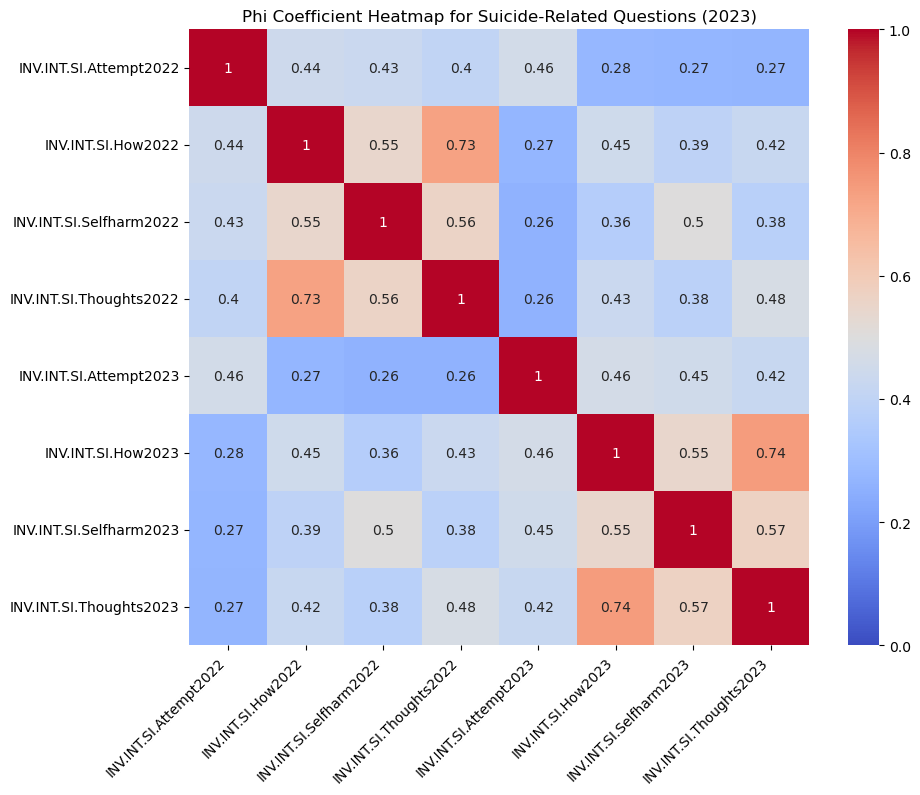

In [147]:
plot_suicide_phi_heatmap(all_linked, suicide, [2022, 2023])

In [122]:
def plot_correlation_heatmaps(df, base_cols, years, corr_type):
    fig, axes = plt.subplots(2, 2, figsize=(12, 12))
    fig.suptitle("Correlation Heatmaps Across Cohorts", fontsize=16)

    for i, cohort in enumerate(cohorts):
        row, col = divmod(i, 2) 
        cohort_df = get_cohort_data(df, base_cols, cohort, years)

        if cohort_df.shape[1] > 1:
            corr_matrix = cohort_df.corr(method=corr_type)
            sns.heatmap(corr_matrix, ax=axes[row, col], cmap="coolwarm", annot=True, fmt=".2f")
            axes[row, col].set_title(f"Cohort {cohort}")
        else:
            axes[row, col].axis("off")

    # formatting
    plt.tight_layout(rect=[0, 0, 1, 0.95]) 
    plt.show()


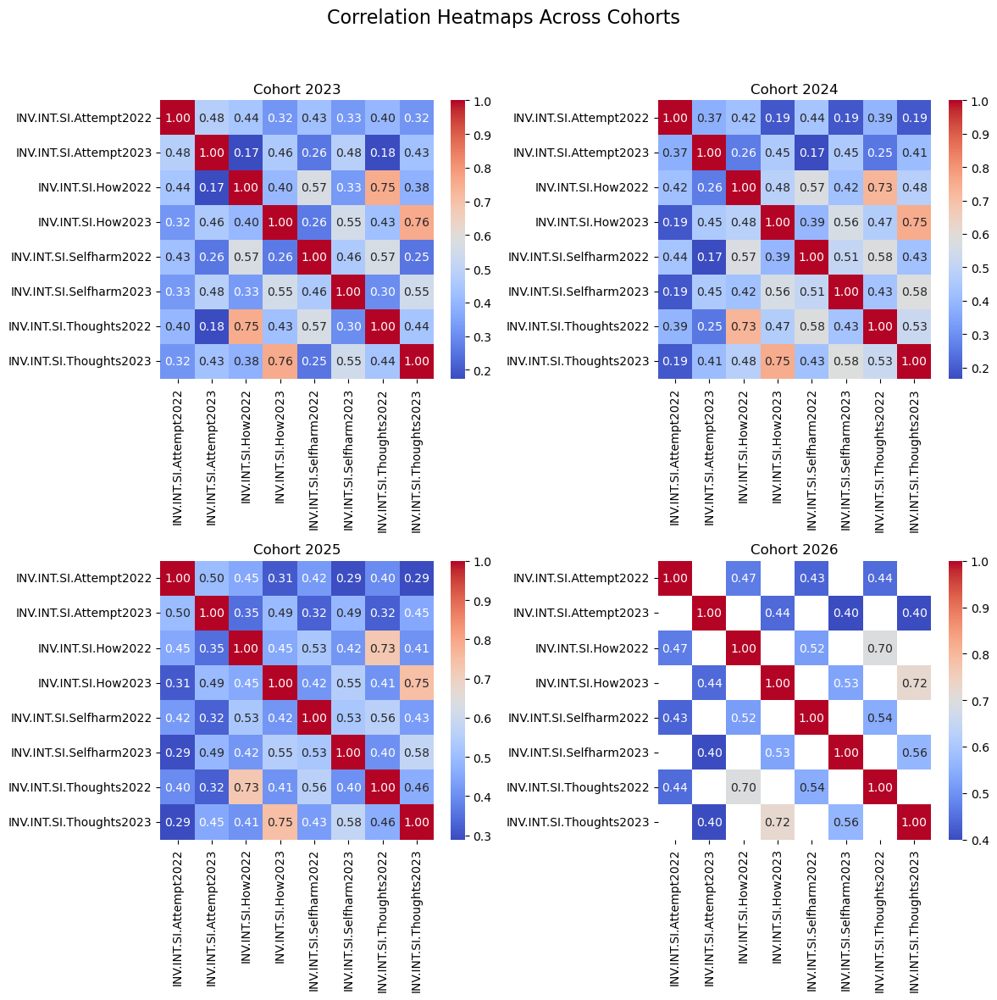

In [123]:
plot_correlation_heatmaps(all_linked, suicide, [2022, 2023], "spearman")

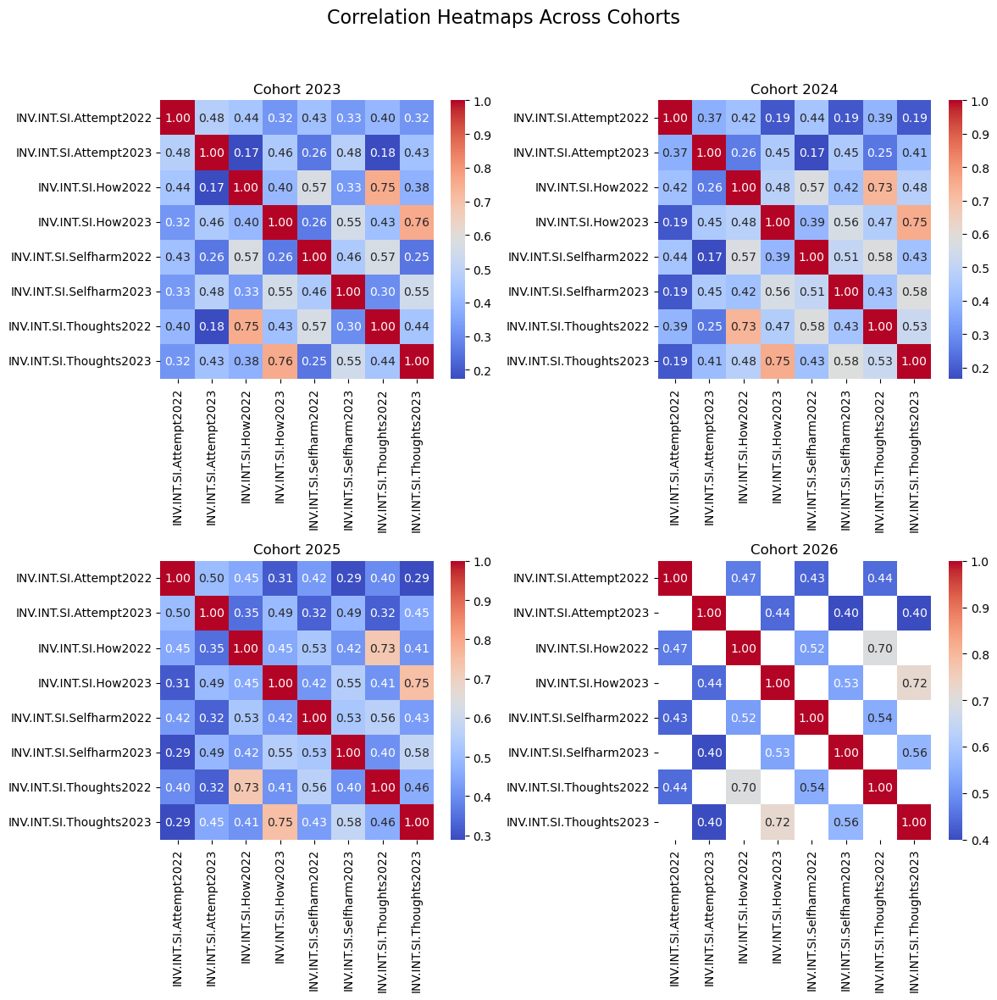

In [124]:
plot_correlation_heatmaps(all_linked, suicide, [2022, 2023], "pearson")

In [ ]:
# format column names  - f"{col}{year}"
def get_yearly_columns(base_cols, years):
    return [f"{col}{year}" for col in base_cols for year in years]

__________

### **Density**

Compares suicidality columns with anxiety/depression scores over different cohorts.

In [95]:
def plot_suicidality_density(df, suicidality_base_col, mental_health_base_cols, method="binned_scatter"):
    for mh_col in mental_health_base_cols: 
        fig, axes = plt.subplots(1, 4, figsize=(20, 5), sharey=True)
        fig.suptitle(f"Density Plot: {suicidality_base_col} vs {mh_col}", fontsize=16)

        for i, cohort in enumerate(cohorts):
            cohort_df = get_cohort_data(df, [suicidality_base_col, mh_col], cohort, [2022, 2023])

            suicidality_col = f"{suicidality_base_col}{years[-1]}" 
            mh_col_yearly = f"{mh_col}{years[-1]}" 

            if suicidality_col in cohort_df.columns and mh_col_yearly in cohort_df.columns:
                if method == "hexbin":
                    hb = axes[i].hexbin(
                        cohort_df[mh_col_yearly], 
                        cohort_df[suicidality_col], 
                        gridsize=20, cmap="viridis", mincnt=1
                    )
                    fig.colorbar(hb, ax=axes[i], label="Count")
                elif method == "binned_scatter":
                    sns.histplot(
                        data=cohort_df, 
                        x=mh_col_yearly, 
                        y=suicidality_col, 
                        bins=(20, 20), 
                        cbar=True, 
                        cmap="viridis", 
                        ax=axes[i]
                    )

            axes[i].set_title(f"Cohort {cohort}")
            axes[i].set_xlabel(mh_col)
            axes[i].set_ylabel(suicidality_base_col)

        plt.tight_layout(rect=[0, 0, 1, 0.95])
        plt.show()


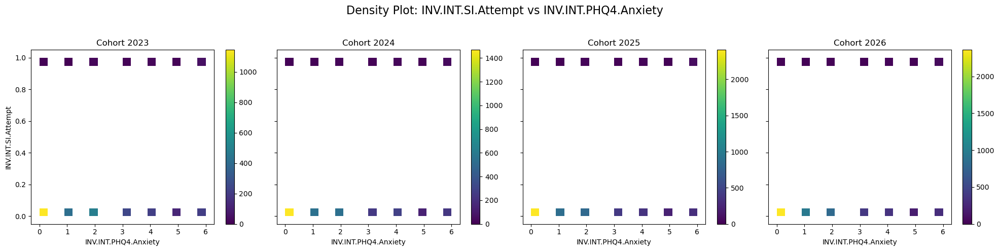

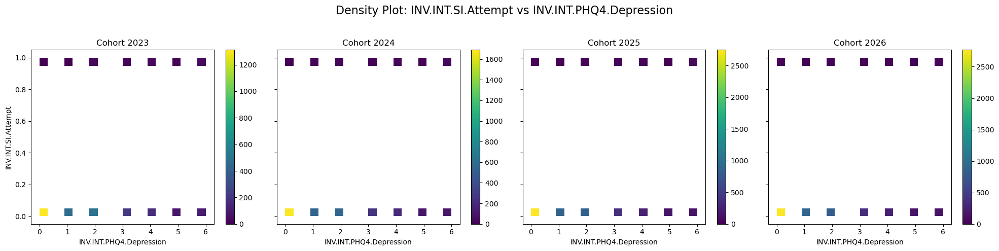

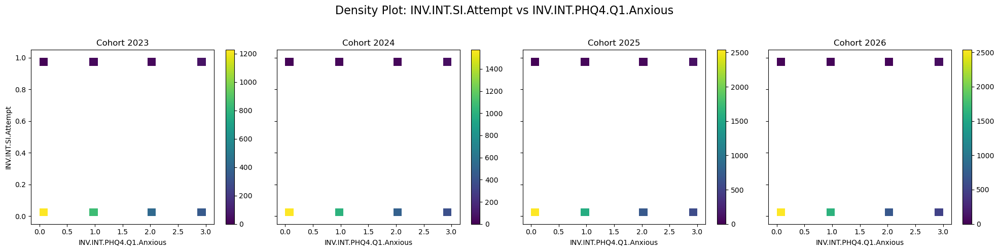

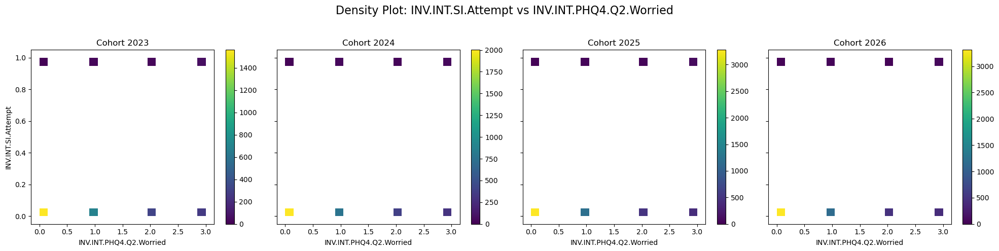

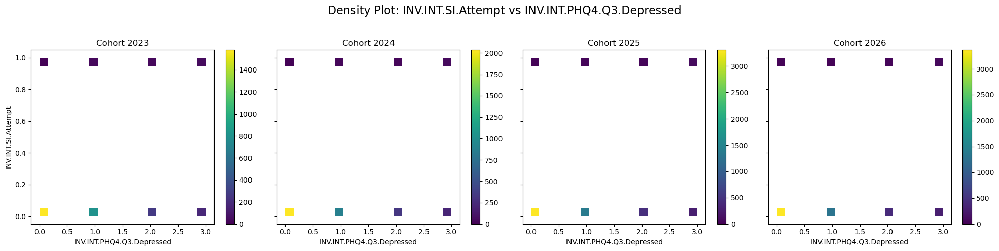

...

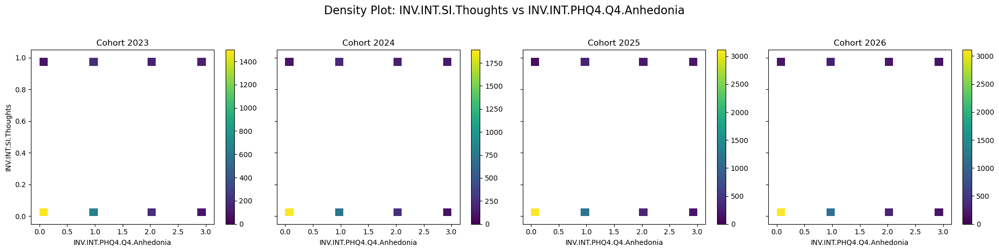

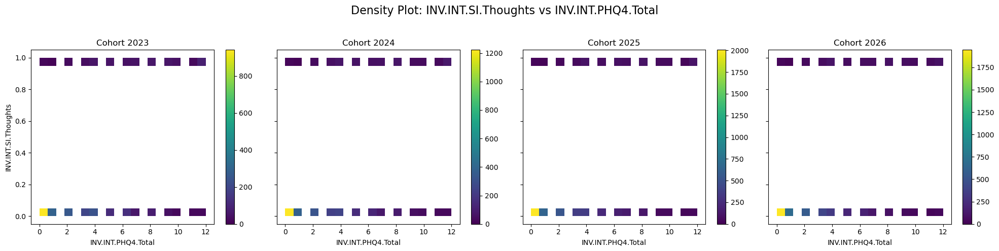

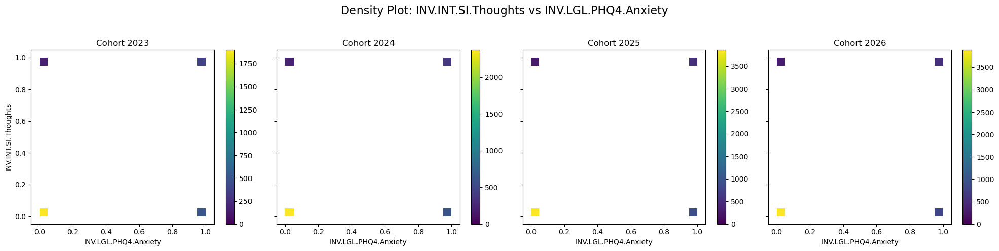

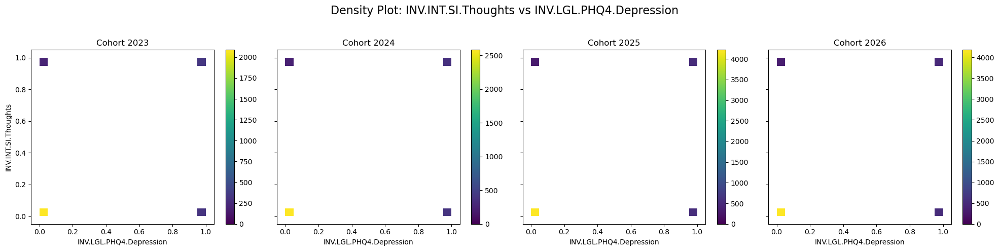

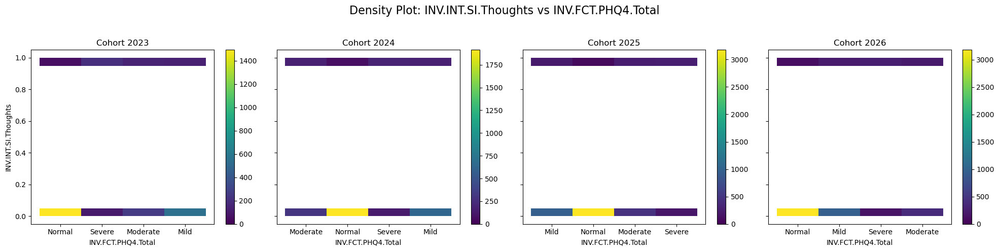

In [97]:
for q in suicide:
    plot_suicidality_density(all_linked, q, phq4, method="binned_scatter")

__________

### **Lagged Correlations**

Past mental health vs. future suicidality

In [157]:
import seaborn as sns
import matplotlib.pyplot as plt
import math
import pandas as pd

def plot_lagged_correlations(df, suicidality_base_col, mental_health_base_cols, year):
    cohort = 2023  # Only analyze Cohort 2023
    cohort_df = get_cohort_data(df, [suicidality_base_col] + mental_health_base_cols, cohort, years)

    suicidality_col_future = f"{suicidality_base_col}{year}"  # Future suicidality variable

    # Ensure suicidality column exists
    if suicidality_col_future not in cohort_df.columns:
        print(f"⚠️ Missing suicidality column: {suicidality_col_future}")
        return

    # Determine subplot grid (4 per row)
    num_cols = len(mental_health_base_cols)
    num_rows = math.ceil(num_cols / 3)  # Compute rows needed
    fig, axes = plt.subplots(num_rows, 3, figsize=(20, 5 * num_rows))  # Adjust figure size dynamically

    # Flatten axes array for easy indexing
    axes = axes.flatten()

    for i, mh_col in enumerate(mental_health_base_cols):
        mh_col_past = f"{mh_col}{years[0]}"  # Earliest year (lagged)

        if mh_col_past in cohort_df.columns:
            # Convert columns to numeric (force errors='coerce' to handle bad values)
            cohort_df[mh_col_past] = pd.to_numeric(cohort_df[mh_col_past], errors='coerce')
            cohort_df[suicidality_col_future] = pd.to_numeric(cohort_df[suicidality_col_future], errors='coerce')

            # Drop NaNs before plotting
            plot_df = cohort_df[[mh_col_past, suicidality_col_future]].dropna()

            if plot_df.empty:
                print(f"⚠️ Not enough valid data for {mh_col_past} vs {suicidality_col_future}")
                axes[i].axis("off")
                continue

            sns.regplot(x=plot_df[mh_col_past], y=plot_df[suicidality_col_future], ax=axes[i])
            axes[i].set_title(f"{mh_col_past} vs {suicidality_col_future}")
            axes[i].set_xlabel(mh_col_past)
            axes[i].set_ylabel(suicidality_col_future)
        else:
            print(f"⚠️ Missing column: {mh_col_past}")
            axes[i].axis("off")  # Hide subplot if missing data

    # Hide unused subplots
    for j in range(i + 1, len(axes)):
        axes[j].axis("off")

    plt.tight_layout(rect=[0, 0, 1, 0.95])
    plt.show()


⚠️ Not enough valid data for INV.FCT.PHQ4.Total2020 vs INV.INT.SI.Attempt2022


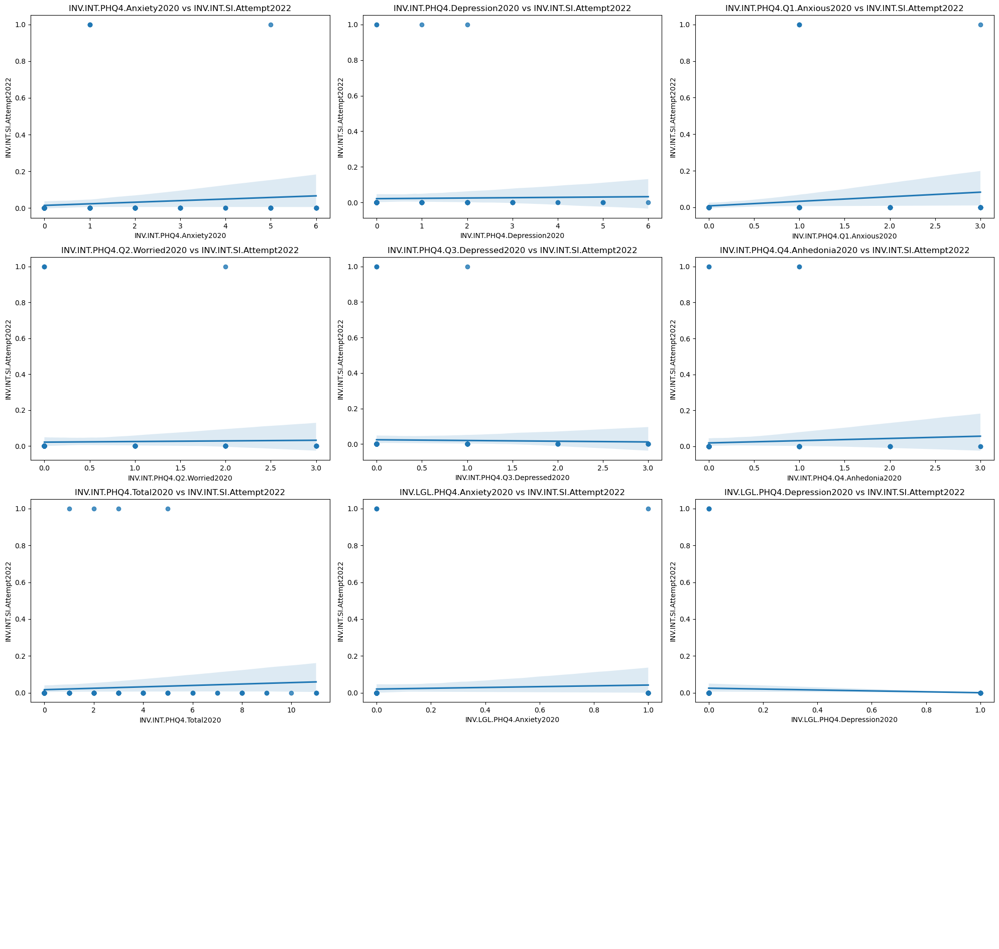

⚠️ Not enough valid data for INV.FCT.PHQ4.Total2020 vs INV.INT.SI.Attempt2023


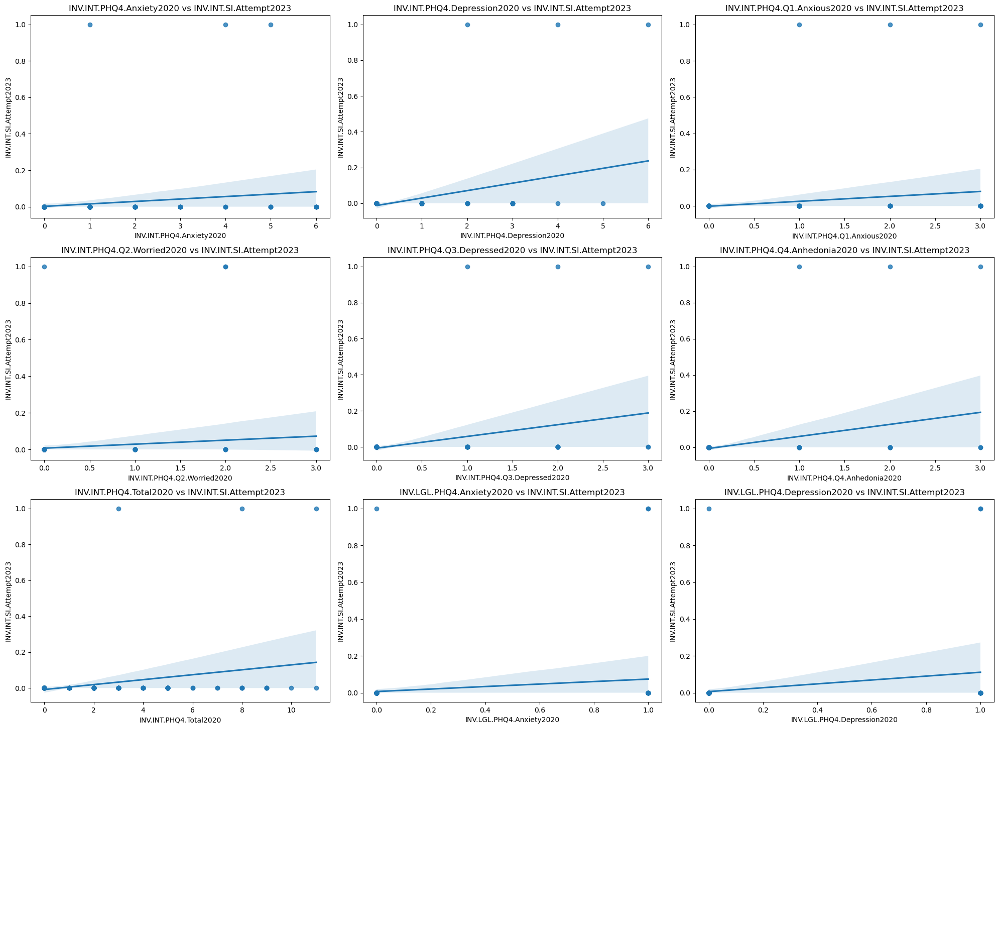

⚠️ Not enough valid data for INV.FCT.PHQ4.Total2020 vs INV.INT.SI.How2022


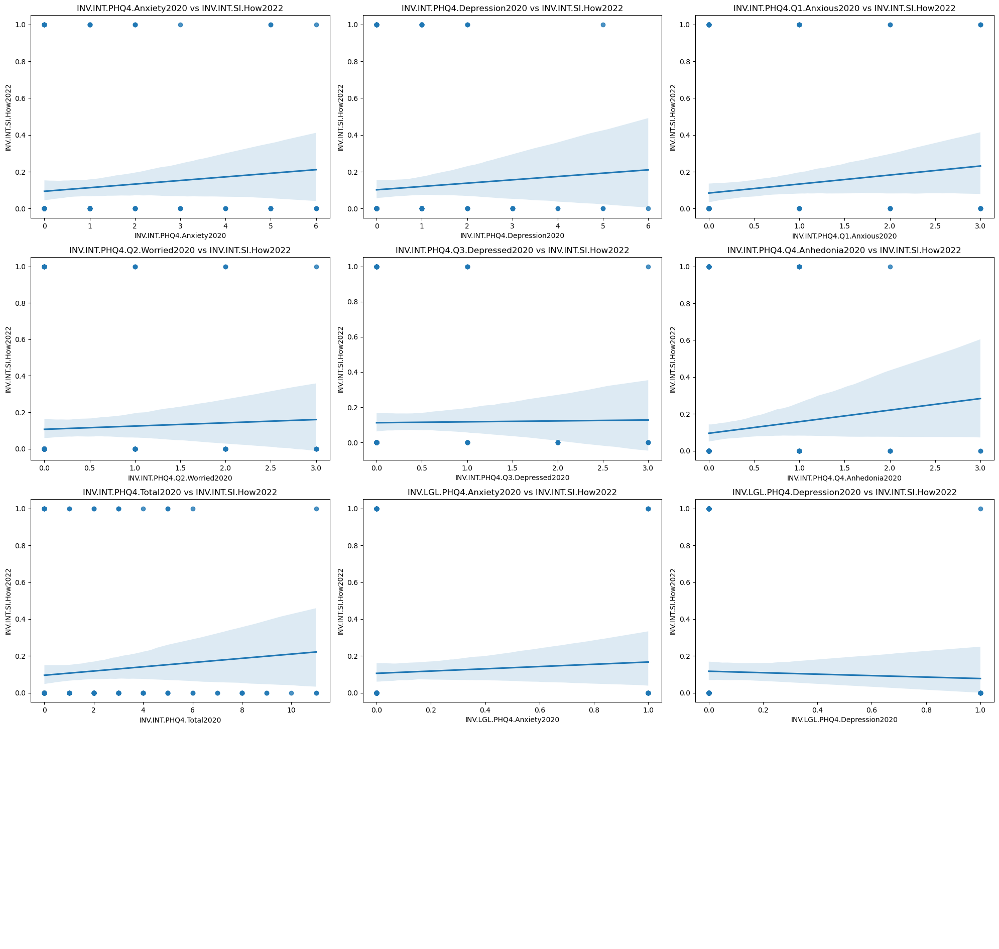

⚠️ Not enough valid data for INV.FCT.PHQ4.Total2020 vs INV.INT.SI.How2023


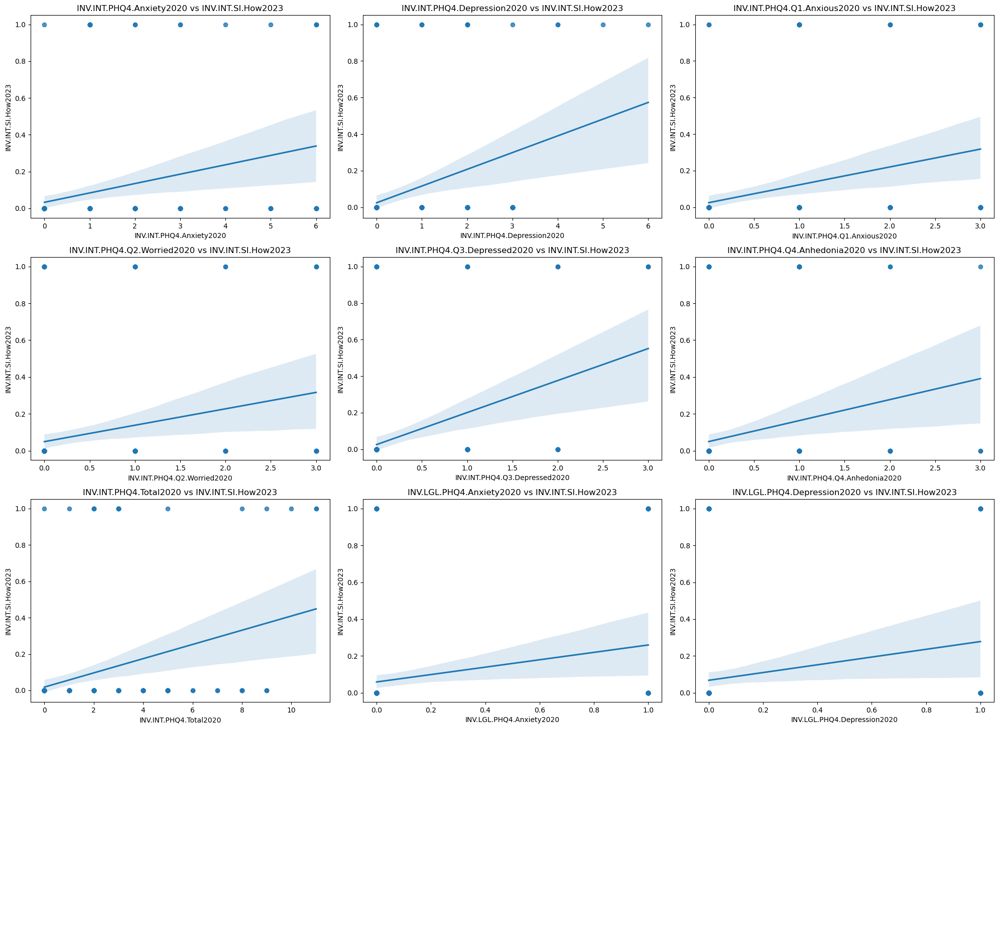

⚠️ Not enough valid data for INV.FCT.PHQ4.Total2020 vs INV.INT.SI.Selfharm2022


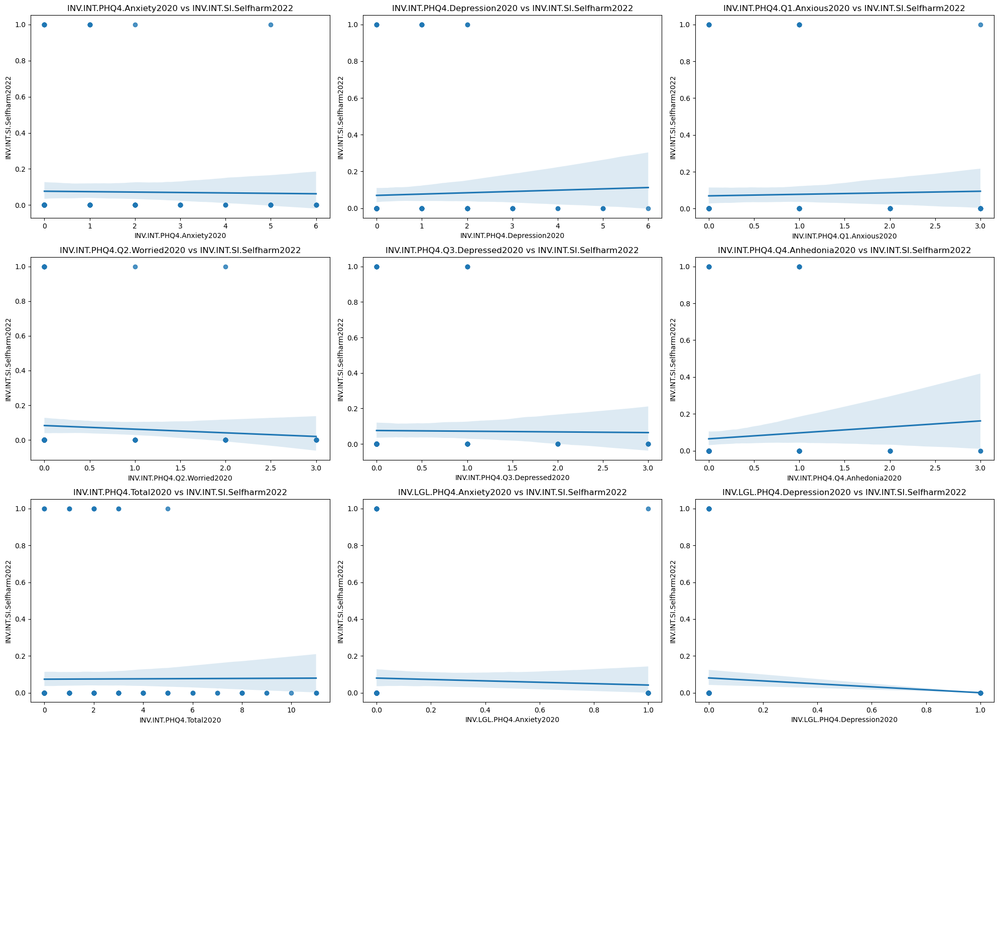

⚠️ Not enough valid data for INV.FCT.PHQ4.Total2020 vs INV.INT.SI.Selfharm2023


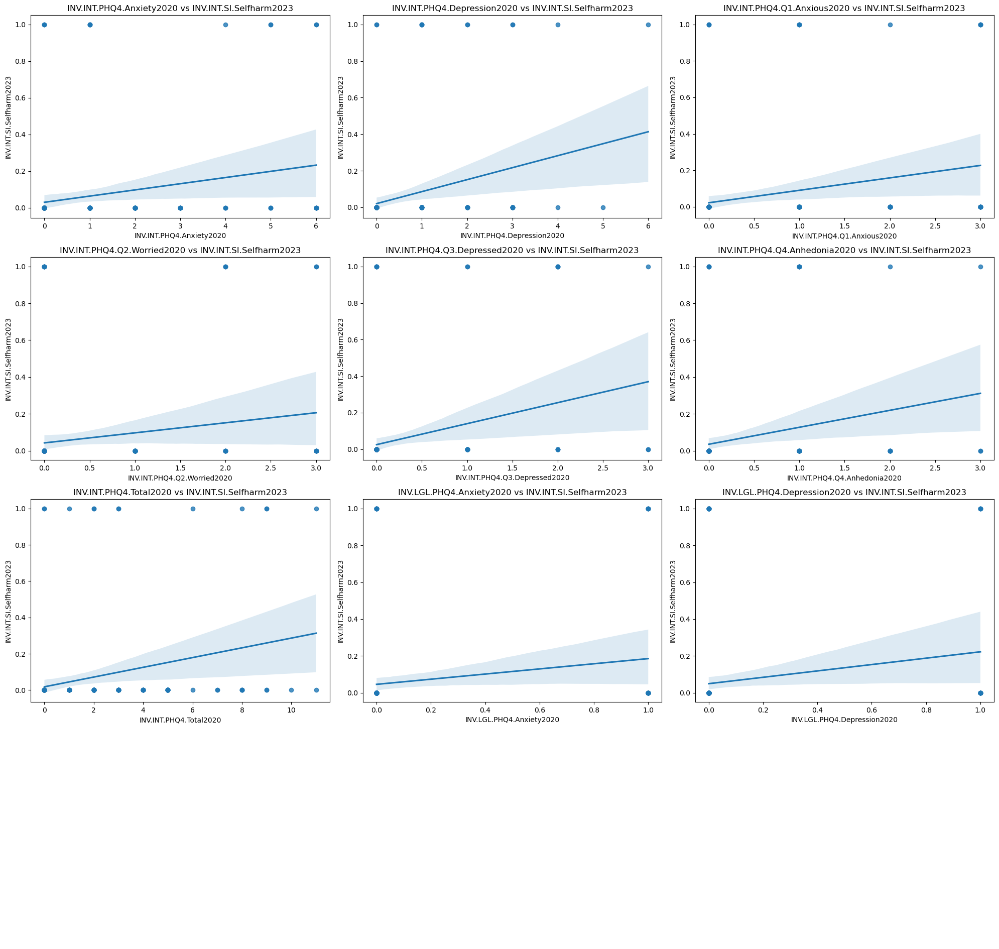

⚠️ Not enough valid data for INV.FCT.PHQ4.Total2020 vs INV.INT.SI.Thoughts2022


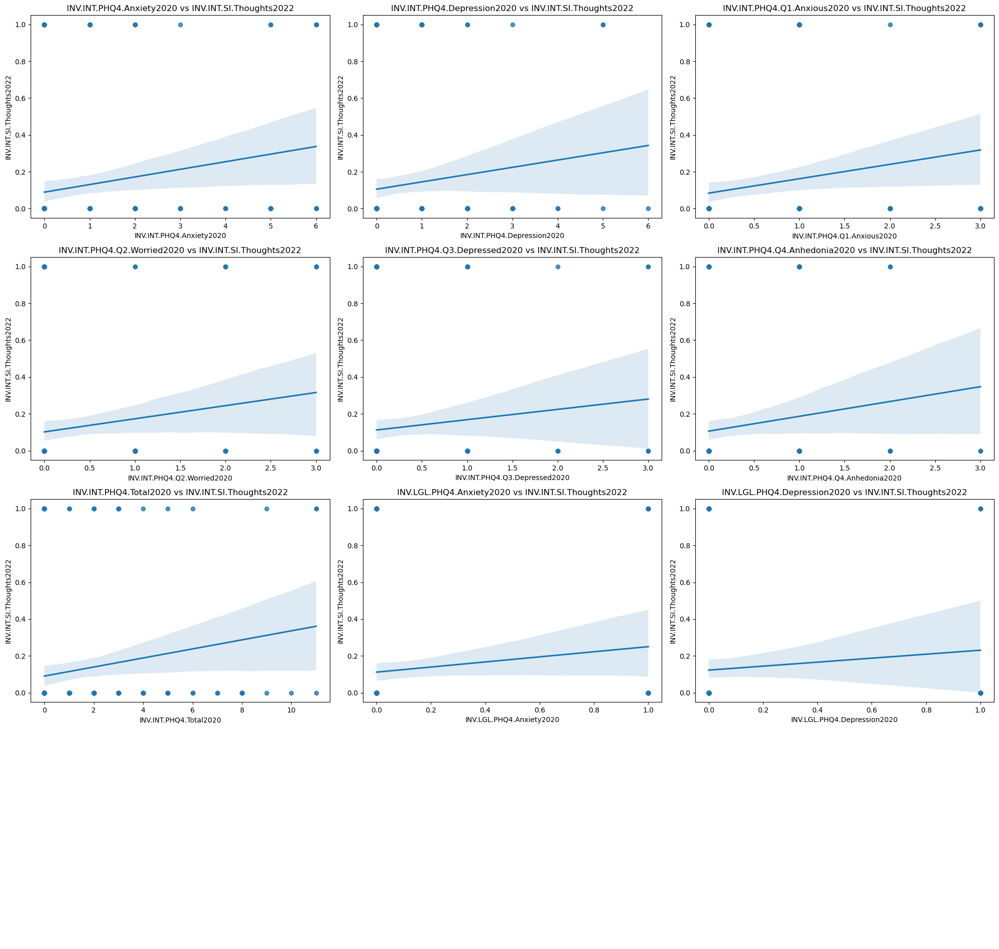

⚠️ Not enough valid data for INV.FCT.PHQ4.Total2020 vs INV.INT.SI.Thoughts2023


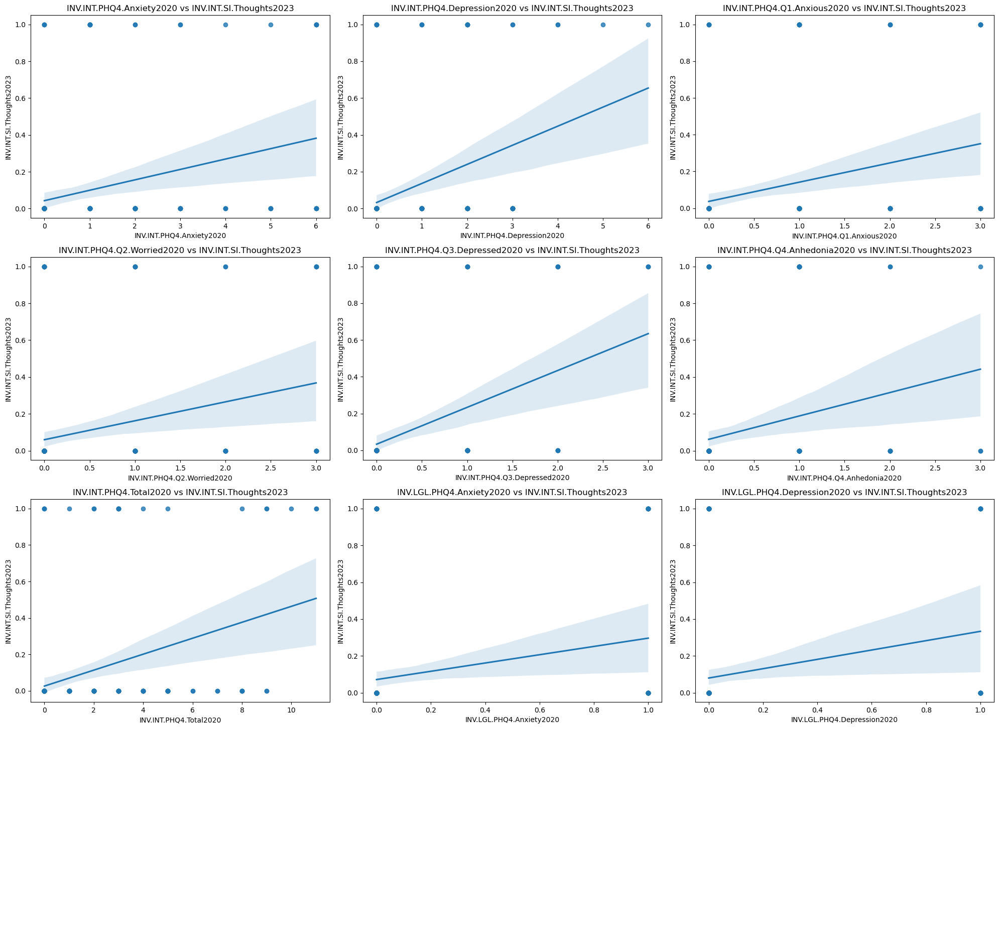

In [158]:
for q in suicide:
    for year in [2022, 2023]:
        plot_lagged_correlations(all_linked, q, phq4, year)

__________

### **Risk Group Comparisons**

Comparing correlations in high-risk vs. low-risk students across cohorts.

In [113]:
def plot_risk_group_comparisons(df, suicidality_base_col, mental_health_base_cols):
    for mh_col in mental_health_base_cols:  # Loop through each mental health column
        fig, axes = plt.subplots(1, 4, figsize=(20, 5))
        fig.suptitle(f"High-Risk vs Low-Risk Group Comparisons ({suicidality_base_col} vs {mh_col})", fontsize=16)

        for i, cohort in enumerate(cohorts):
            # Format the correct column names for the latest year
            suicidality_col = f"{suicidality_base_col}{years[-1]}"  # Latest year
            mh_col_yearly = f"{mh_col}{years[-1]}"  # Latest year

            # Get cohort data for selected columns
            cohort_df = get_cohort_data(df, [suicidality_base_col, mh_col], cohort, years)

            # Ensure both columns exist before proceeding
            if cohort_df is not None and suicidality_col in cohort_df.columns and mh_col_yearly in cohort_df.columns:
                # Drop NaN values before categorizing risk groups
                cohort_df = cohort_df[[suicidality_col, mh_col_yearly]].dropna()

                if cohort_df.empty:
                    print(f"Not enough valid data for cohort {cohort}")
                    axes[i].axis("off")
                    continue

                # Categorize into high vs. low risk groups
                cohort_df["RiskGroup"] = cohort_df[suicidality_col].apply(lambda x: "High" if x == 1 else "Low")

                # Plot boxplot
                sns.boxplot(data=cohort_df, x="RiskGroup", y=mh_col_yearly, ax=axes[i])

                axes[i].set_title(f"Cohort {cohort}")
                axes[i].set_xlabel("Risk Group")
                axes[i].set_ylabel(mh_col)

            else:
                print(f"Missing required columns for cohort {cohort}: {suicidality_col} or {mh_col_yearly}")
                axes[i].axis("off")  # Hide subplot if data is missing

        plt.tight_layout(rect=[0, 0, 1, 0.95])
        plt.show()


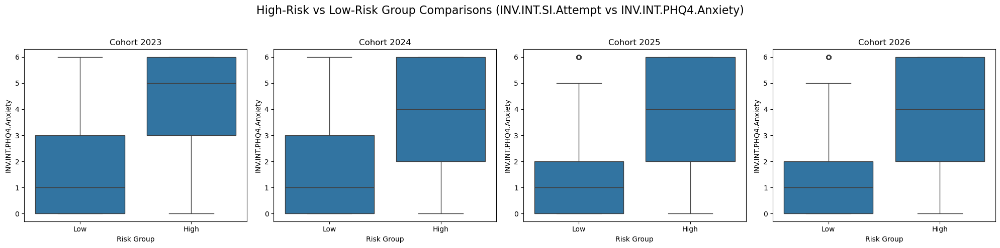

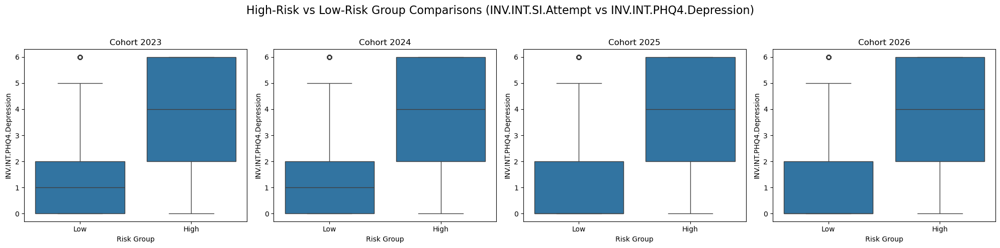

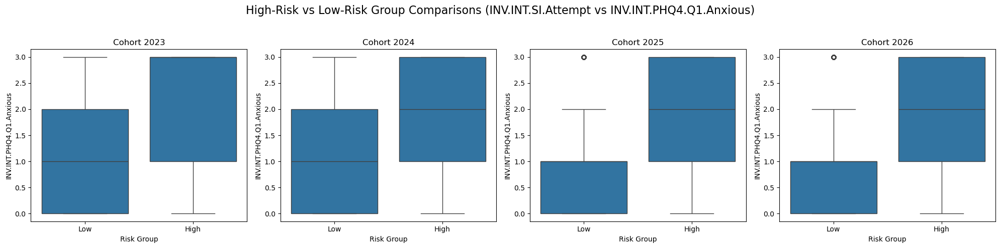

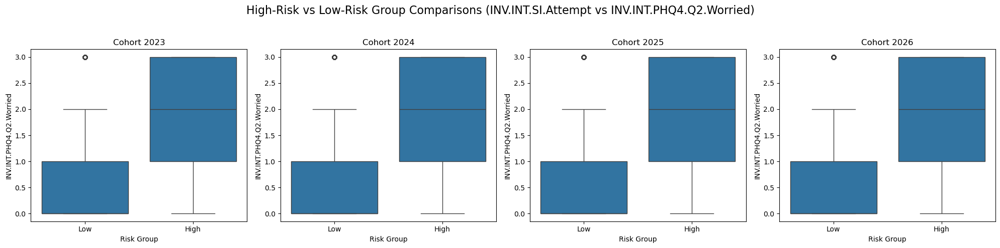

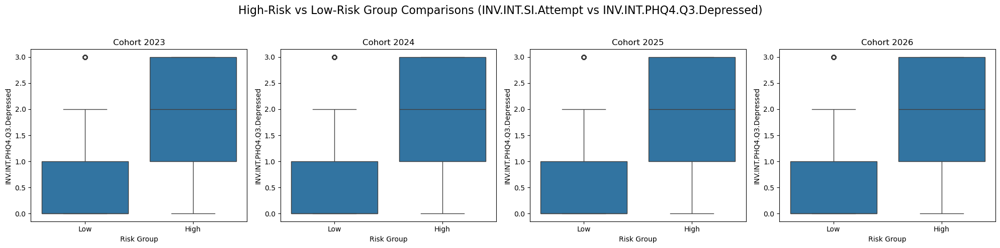

...

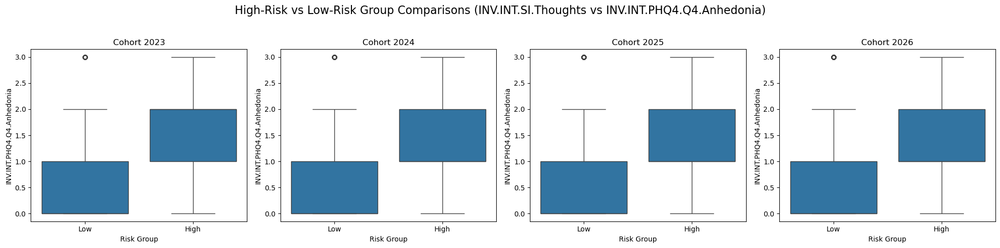

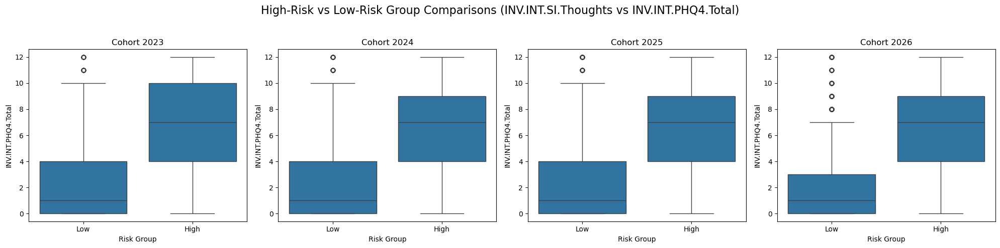

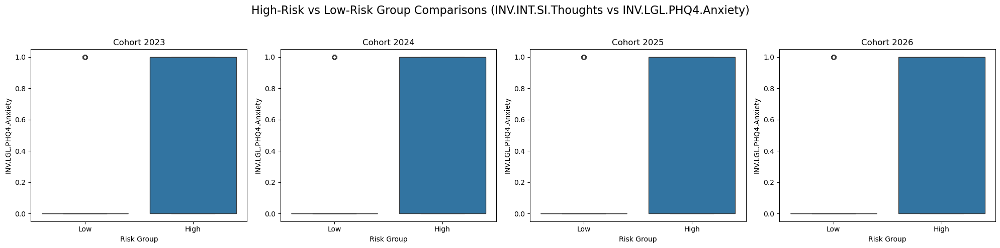

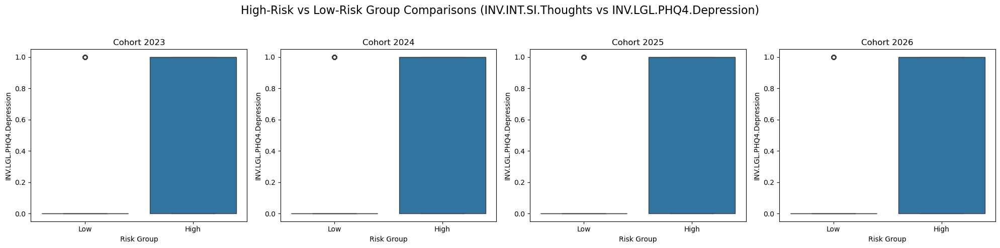

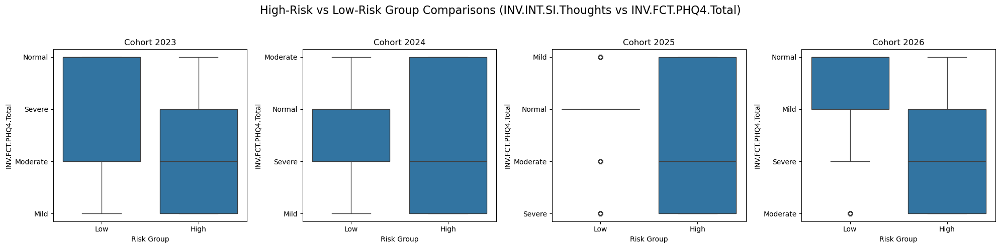

In [115]:
for q in suicide:
    plot_risk_group_comparisons(all_linked, q, phq4)

__________

### **Clustering**

Cluster students based on anxiety, depression, self-harm, suicidality

In [120]:
def plot_suicidality_clusters(df, suicidality_base_cols):
    fig, axes = plt.subplots(1, 4, figsize=(20, 5))
    fig.suptitle("Clustering of Suicidality Profiles", fontsize=16)

    for i, cohort in enumerate(cohorts):
        cohort_df = get_cohort_data(df, suicidality_base_cols, cohort, [2022, 2023]).dropna()

        if cohort_df.shape[0] > 0:
            kmeans = KMeans(n_clusters=3, random_state=42).fit(cohort_df)
            cohort_df["cluster"] = kmeans.labels_

            sns.scatterplot(data=cohort_df, x=f"{suicidality_base_cols[0]}{years[-1]}", 
                            y=f"{suicidality_base_cols[1]}{years[-1]}", hue="cluster", ax=axes[i])
            axes[i].set_title(f"Cohort {cohort}")

    plt.tight_layout(rect=[0, 0, 1, 0.95])
    plt.show()


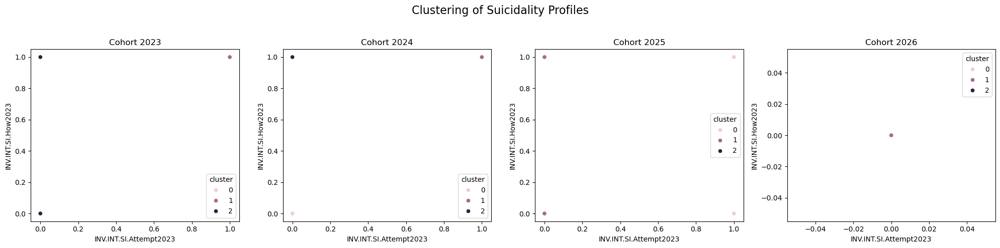

In [121]:
plot_suicidality_clusters(all_linked, suicide)

In [162]:
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd

def plot_categorical_distributions(df, categorical_base_cols):
    """Plots bar charts showing the distribution of responses across cohorts for categorical questions, including NaNs as a category."""

    for col in categorical_base_cols:
        fig, axes = plt.subplots(1, len(cohorts), figsize=(20, 5), sharey=True)
        fig.suptitle(f"Distribution of Responses for {col} Across Cohorts", fontsize=16)

        for i, cohort in enumerate(cohorts):
            # Format column names with years
            cohort_cols = [f"{col}{year}" for year in years if f"{col}{year}" in df.columns]

            if not cohort_cols:
                print(f"⚠️ No valid columns found for {col} in any year.")
                continue

            # Select cohort data
            cohort_df = get_cohort_data(df, [col], cohort, years)

            # Melt the data to long format
            melted_df = cohort_df.melt(value_vars=cohort_cols, var_name="Year", value_name="Response")

            # Replace NaNs with "Missing" category
            melted_df["Response"] = melted_df["Response"].fillna("Missing")

            if melted_df.empty:
                print(f"⚠️ No valid responses for {col} in cohort {cohort}.")
                axes[i].axis("off")
                continue

            # Plot bar chart
            sns.countplot(data=melted_df, x="Response", hue="Year", ax=axes[i])
            axes[i].set_title(f"Cohort {cohort}")
            axes[i].set_xlabel("Response Category")
            axes[i].set_ylabel("Count")
            axes[i].legend(title="Survey Year")

        plt.tight_layout(rect=[0, 0, 1, 0.95])
        plt.show()


#### **Substance Use**

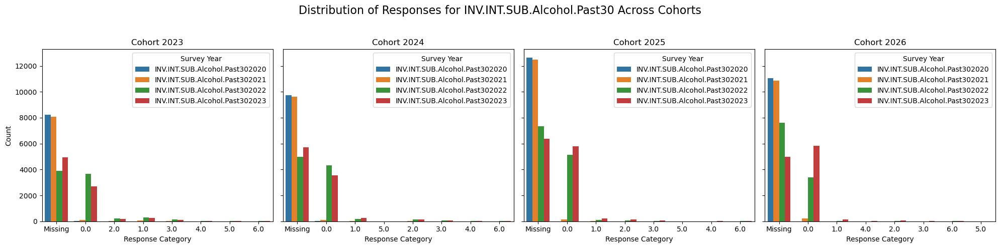

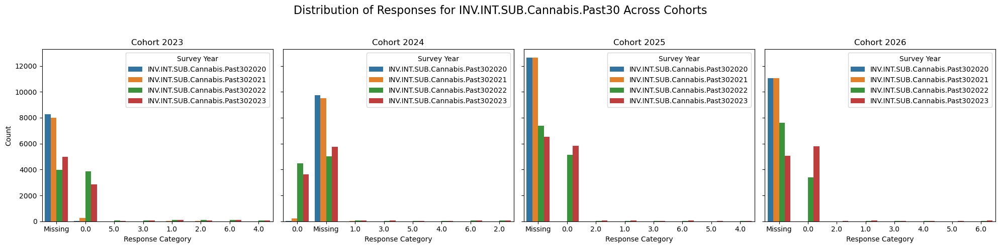

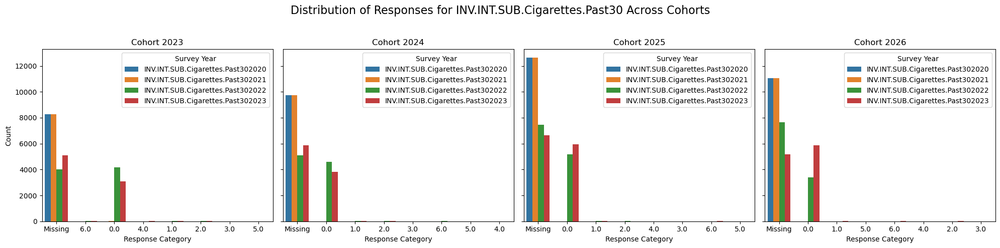

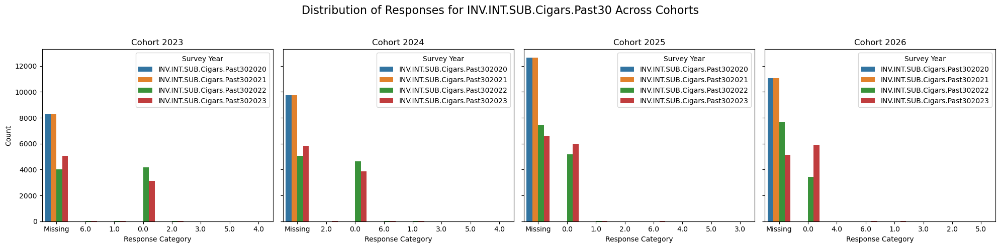

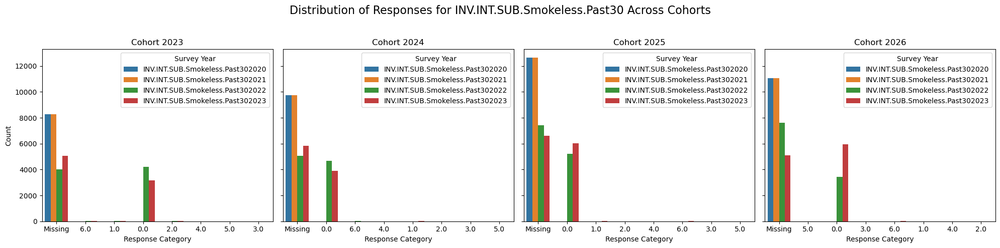

...

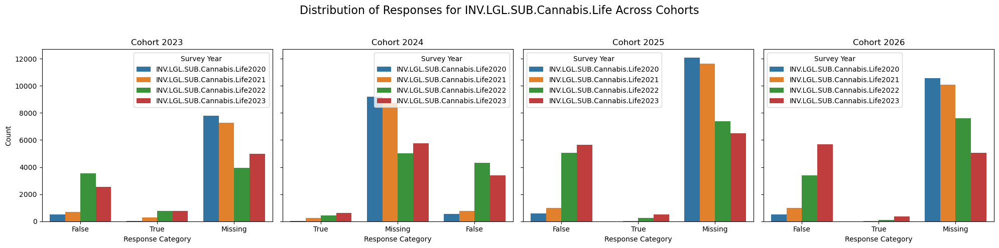

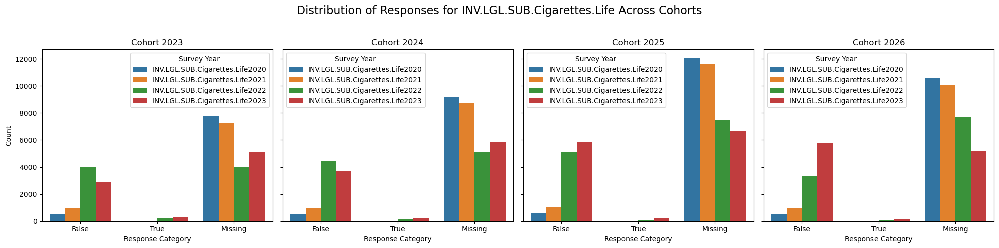

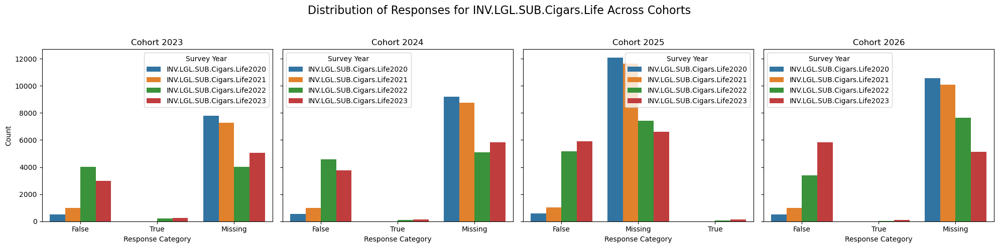

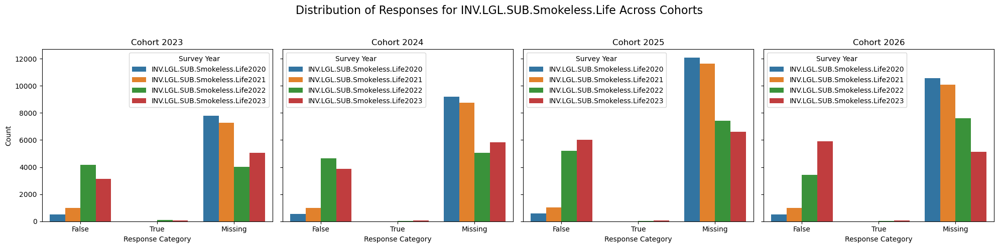

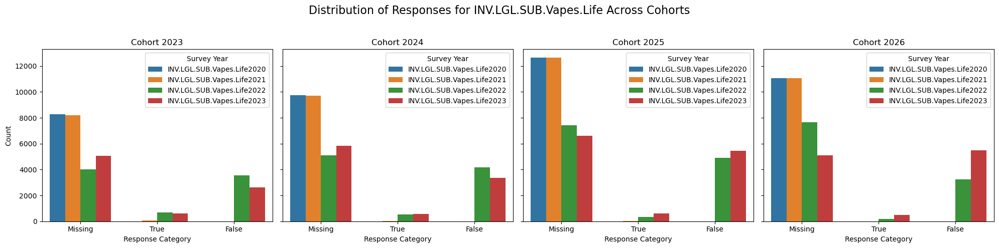

In [173]:
plot_categorical_distributions(all_linked, substance)

#### **PHQ-4**

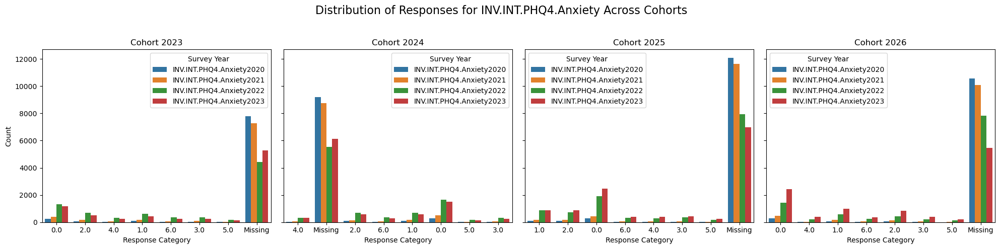

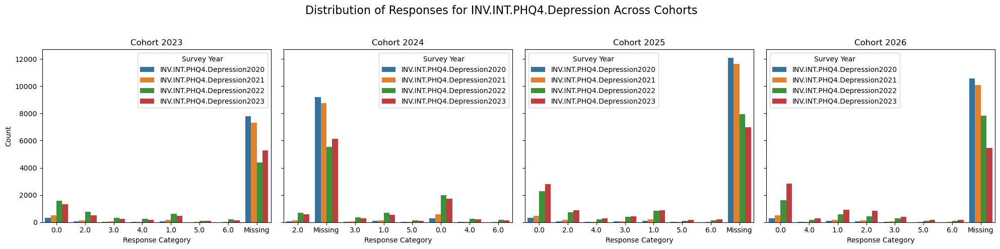

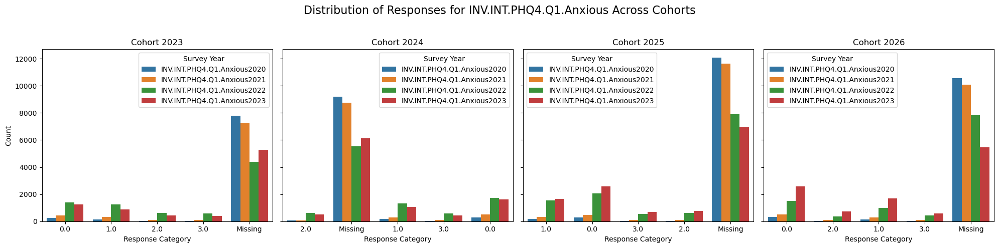

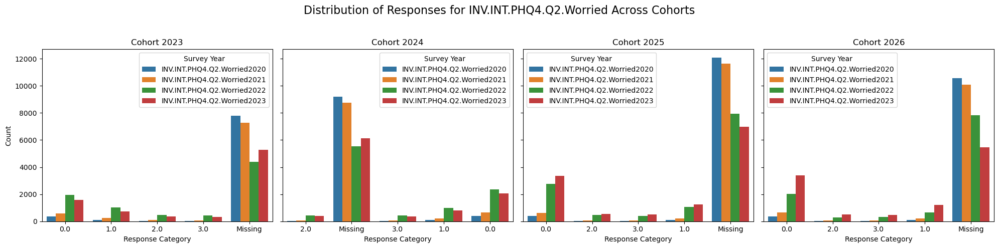

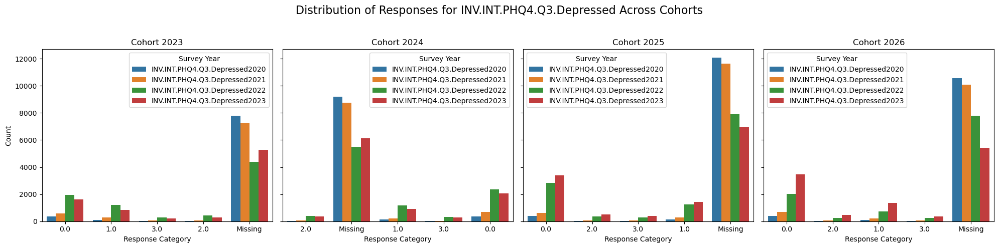

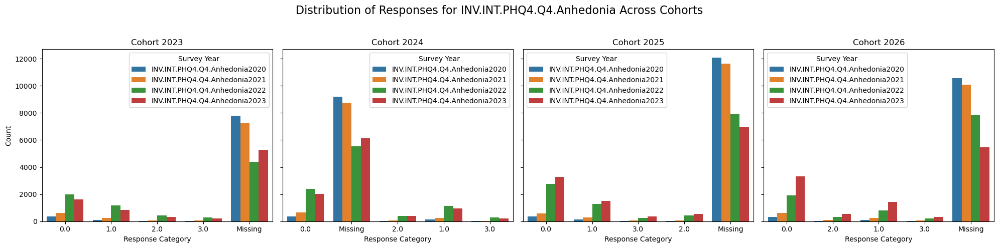

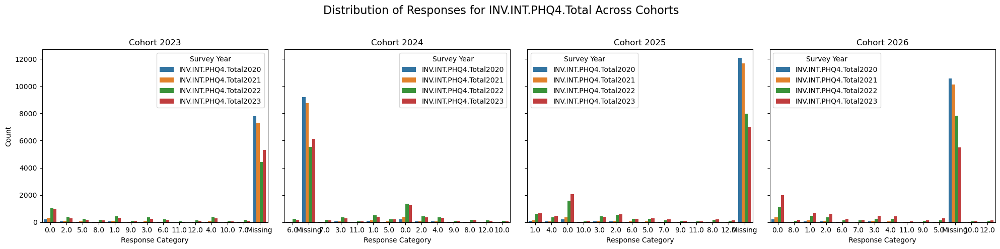

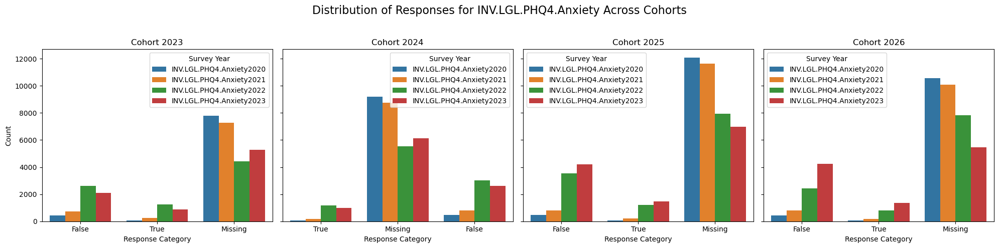

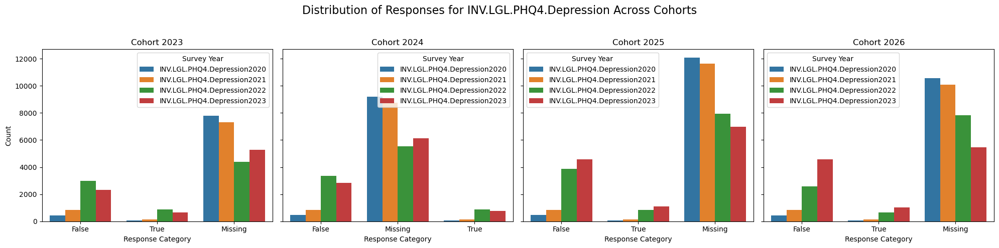

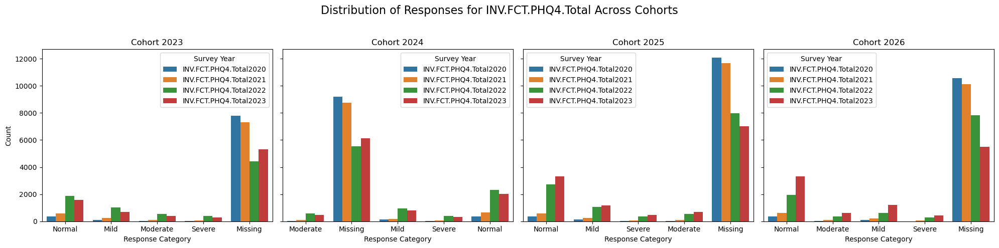

In [168]:
plot_categorical_distributions(all_linked, phq4)

#### **Suicidality**

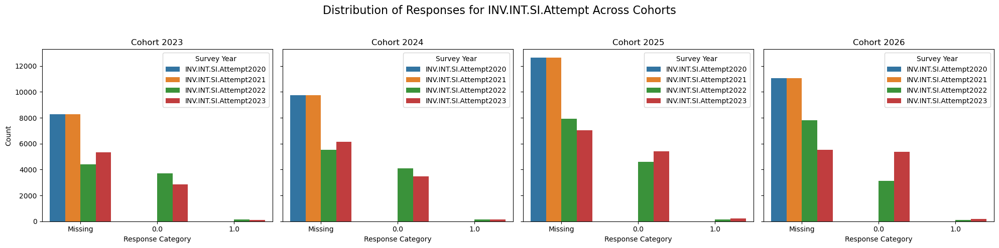

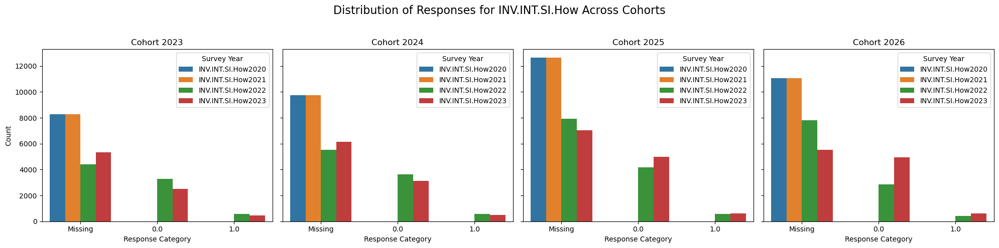

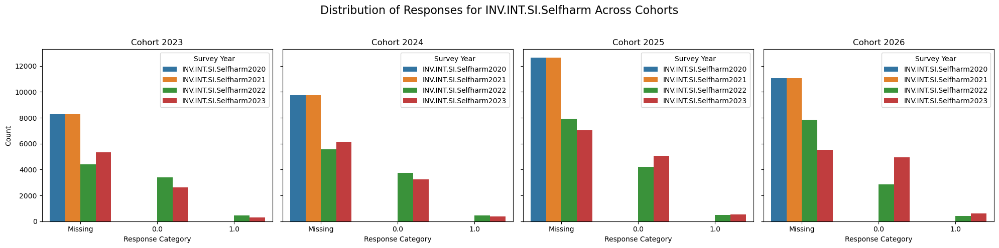

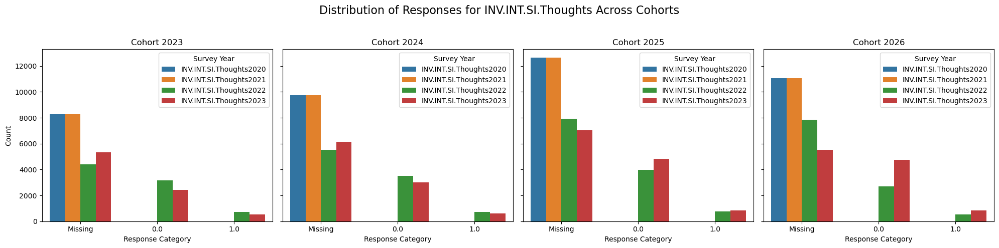

In [169]:
plot_categorical_distributions(all_linked, suicide)

#### **Adolescent Psychotic-Like Symptoms**

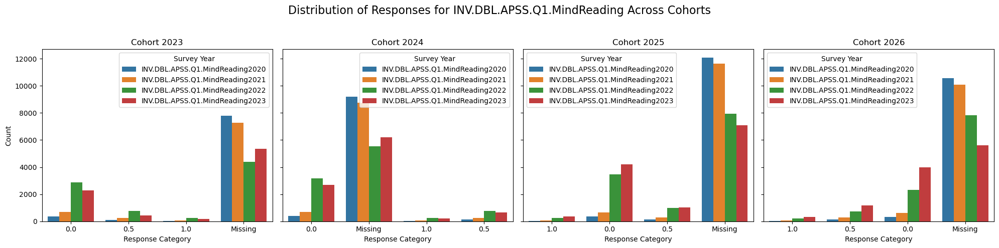

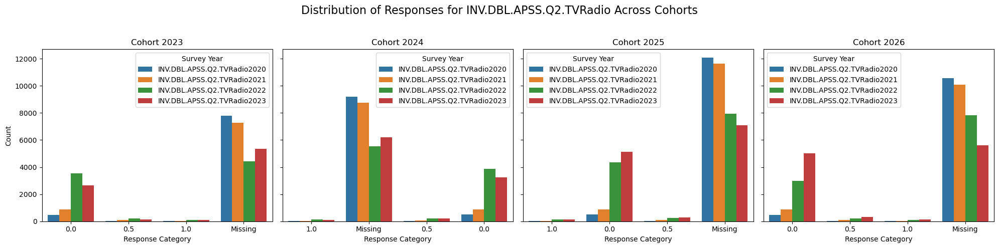

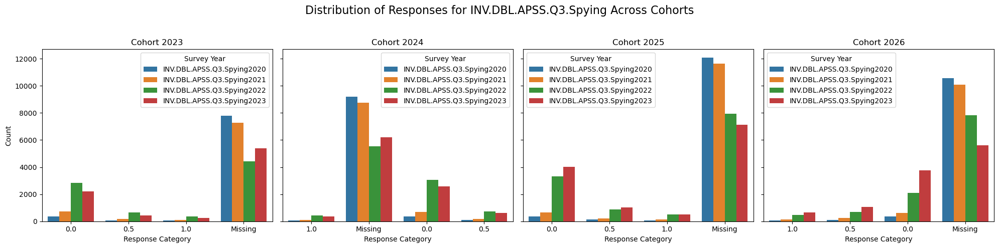

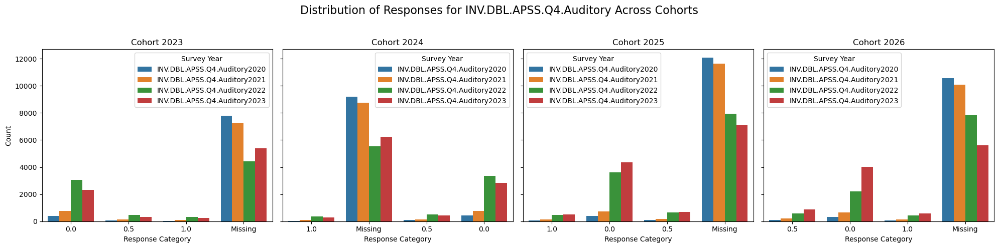

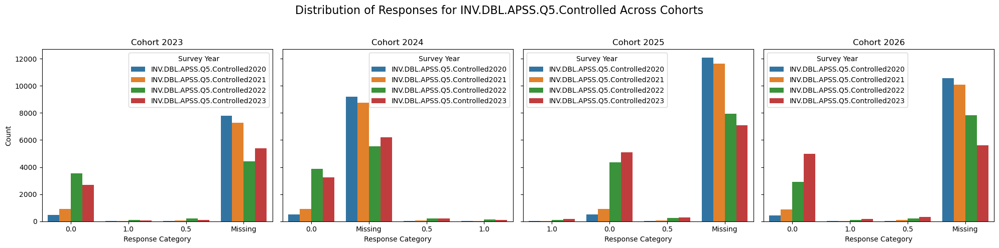

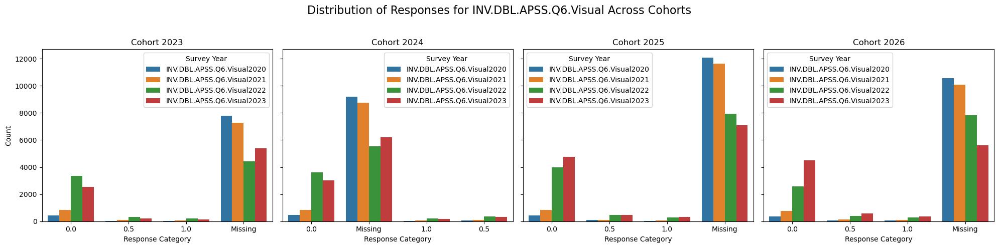

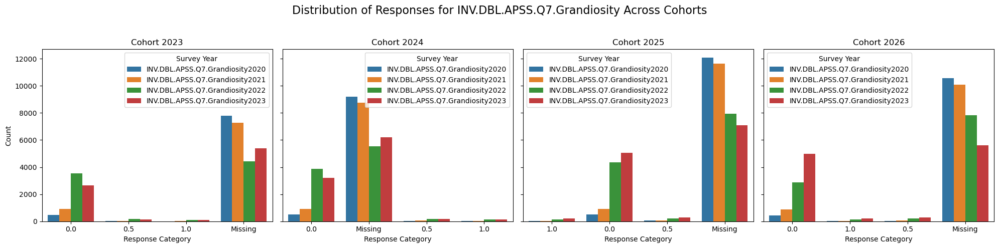

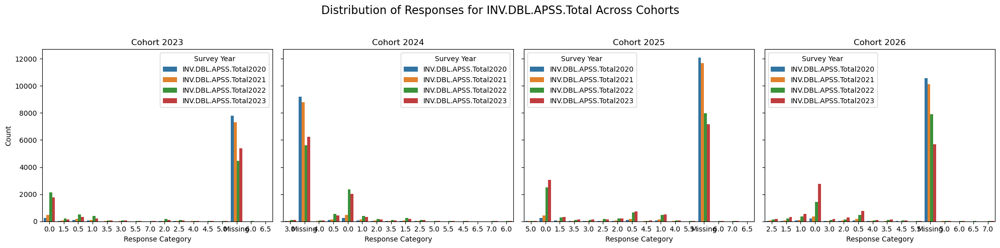

In [170]:
plot_categorical_distributions(all_linked, psychotic)

#### **Emotional Reactivity**

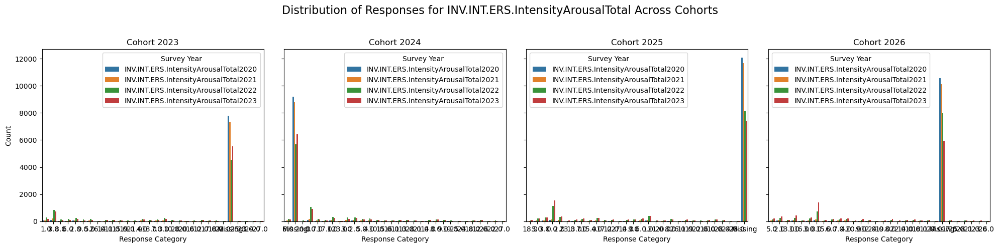

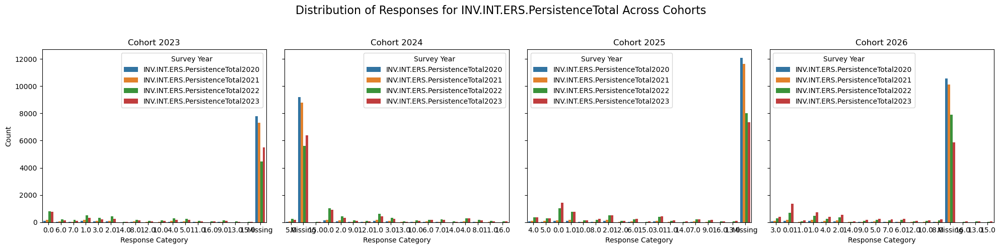

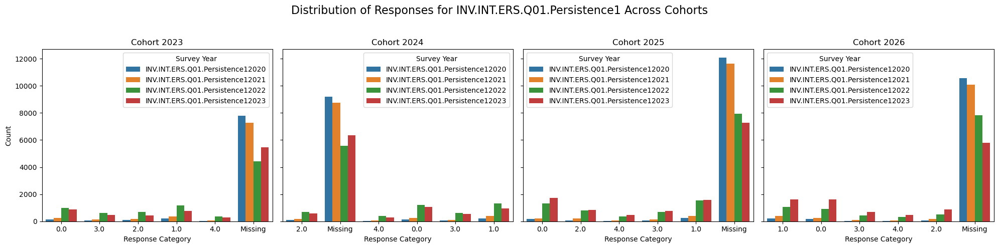

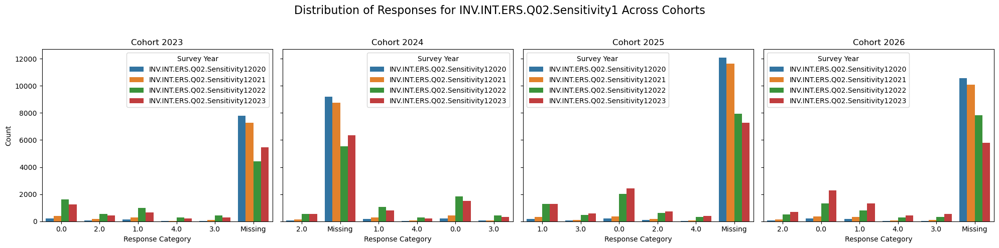

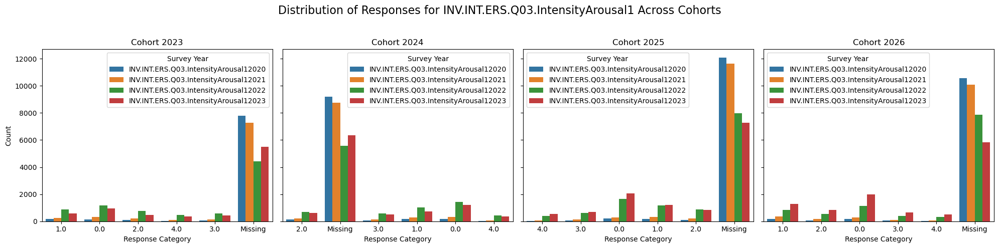

...

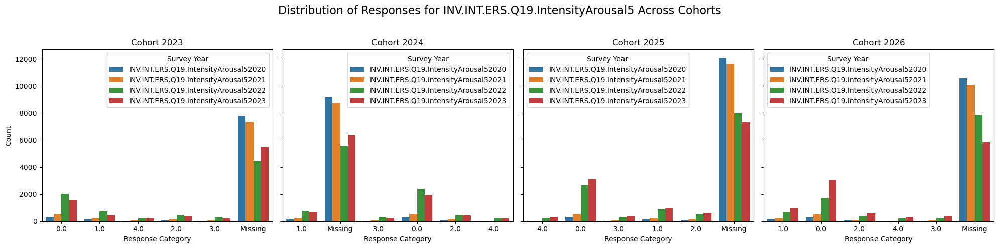

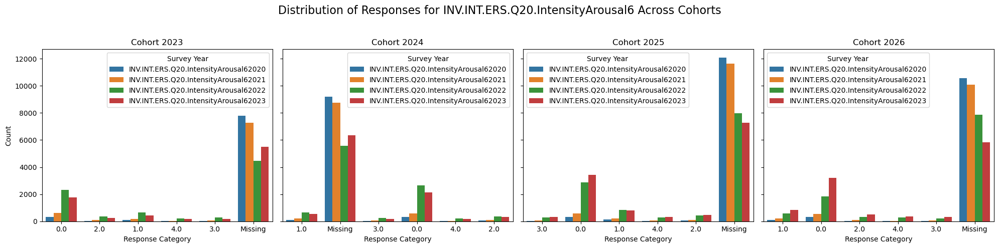

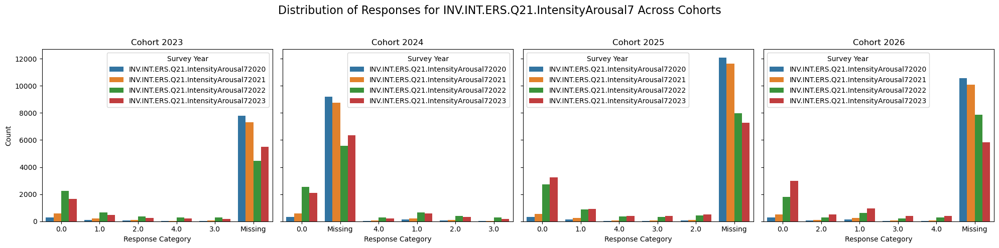

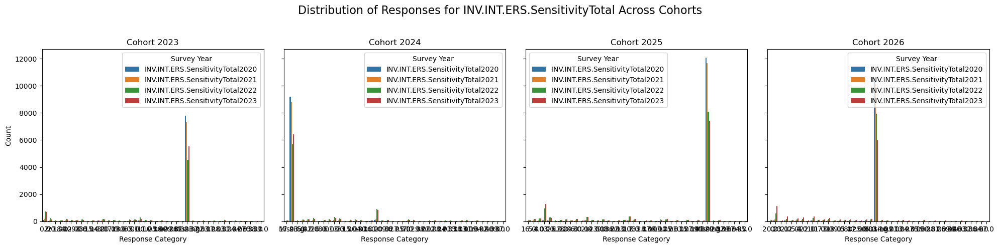

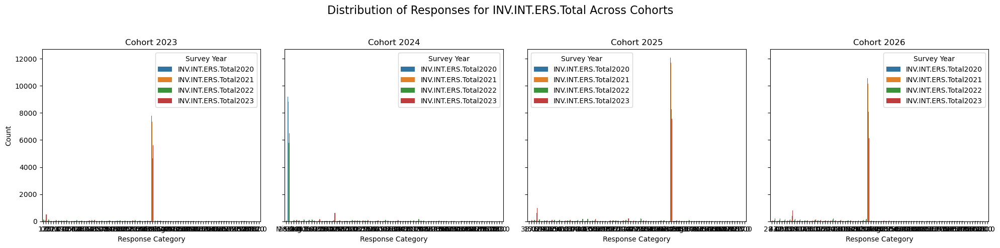

In [171]:
plot_categorical_distributions(all_linked, emotional)

#### **Help Seeking**

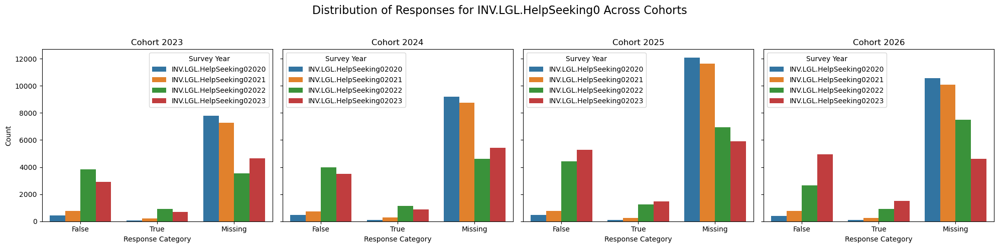

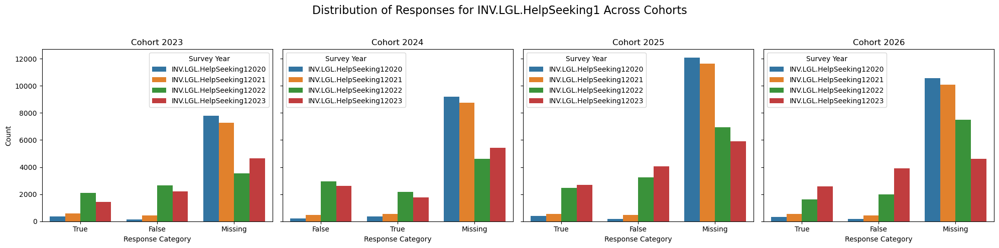

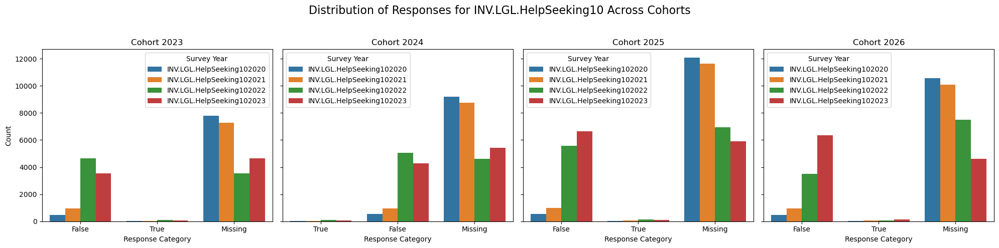

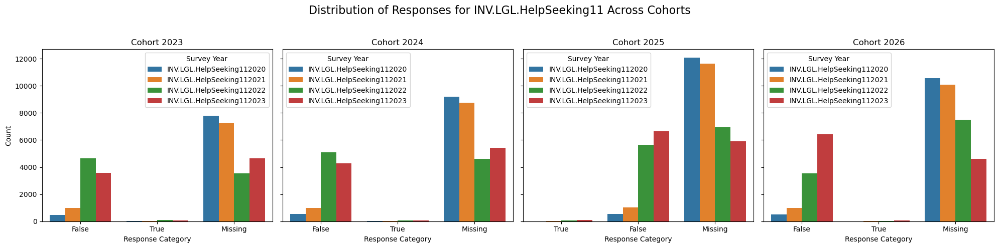

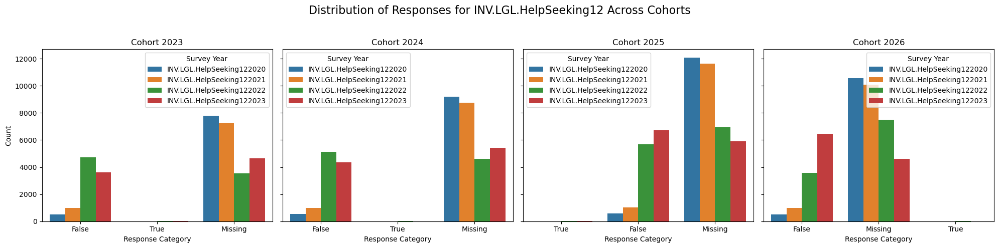

...

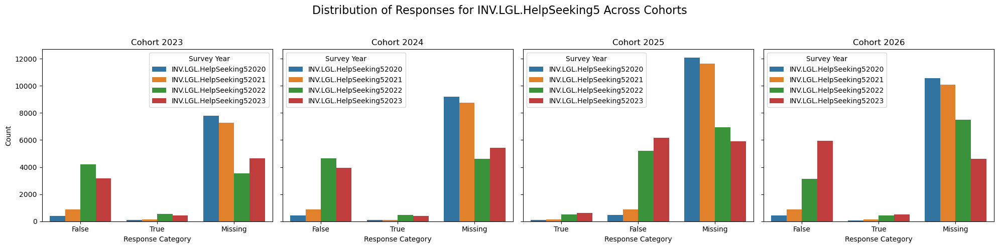

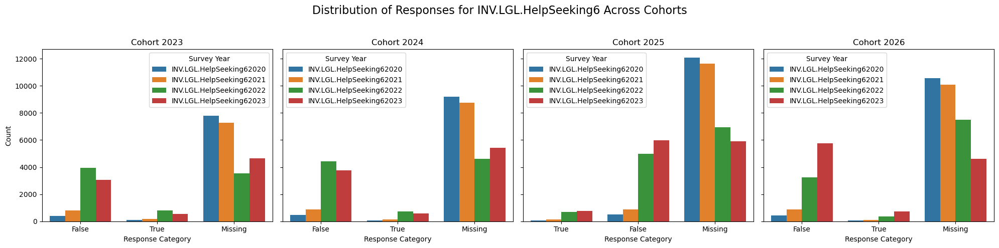

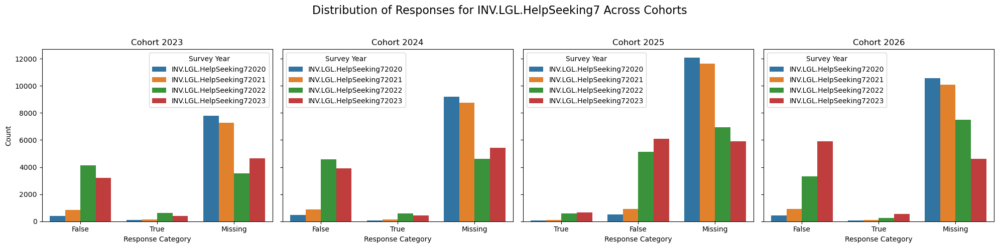

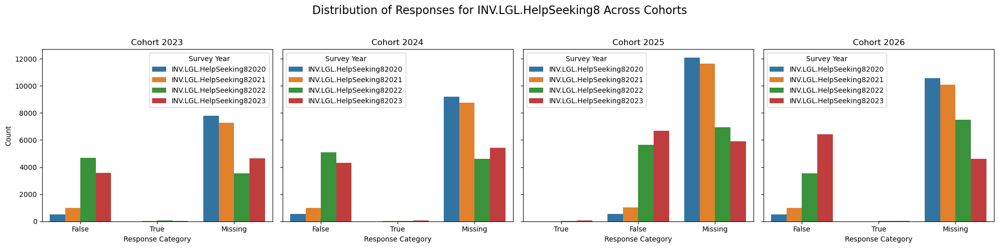

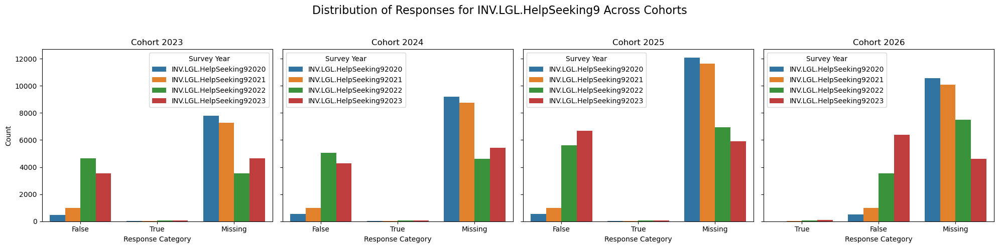

/var/folders/sk/hy6bzzbx4rd98zc284jmxmkm0000gn/T/ipykernel_77136/3267638604.py:41: UserWarning: Tight layout not applied. tight_layout cannot make Axes width small enough to accommodate all Axes decorations
  plt.tight_layout(rect=[0, 0, 1, 0.95])


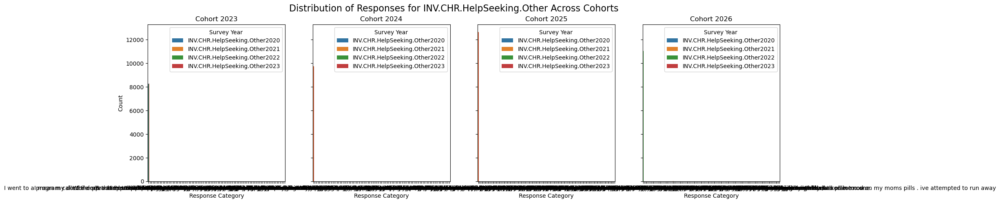

In [172]:
plot_categorical_distributions(all_linked, help)